## Preamble and Function defs

In [1]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torch.optim.lr_scheduler import LambdaLR

import os

from PIL import Image
import numpy as np
import skimage
import matplotlib.pyplot as plt
import cv2

from modules import models
from modules.bspline_w import bspline_wavelet
from modules import utils

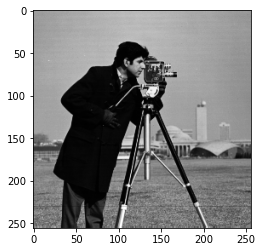

In [2]:
# Read image
image = utils.normalize(plt.imread('data/cameraman.tif').astype(np.float32), True)
H, W = image.shape
img_tensor = torch.tensor(image).cuda().reshape(H*W)[None, ...]

plt.imshow(image, cmap='gray', vmin=0, vmax=1)
plt.show()

In [3]:
x = torch.linspace(-1, 1, W).cuda()
y = torch.linspace(-1, 1, H).cuda()
X, Y = torch.meshgrid(x, y, indexing='xy')
coords = torch.hstack((X.reshape(-1, 1), Y.reshape(-1, 1)))[None, ...]

In [4]:
def big_contribs(deep_neurons, next_linear):
    deep_neurons_scaled = torch.linalg.norm(next_linear.weight.data, dim=1) * deep_neurons.T
    
    l2_norm_atoms = torch.linalg.norm(deep_neurons_scaled, dim=0)
    vals, indx = torch.sort(l2_norm_atoms)
    
    return vals, indx

## BW-ReLU Experiments 

In [5]:
device = 'cuda:0'
torch.manual_seed(40)
model_bw_relu = models.get_INR(
            nonlin='symmetric-bspline-w',
            in_features=2,
            out_features=1, 
            hidden_features=300,
            hidden_layers=3,
            c=3)

model_bw_relu.to(device)

INR(
  (net): Sequential(
    (0): BsplineWaveletLayer(
      (block): Sequential(
        (linear): Linear(in_features=2, out_features=300, bias=True)
        (bspline_w): BSplineWavelet()
      )
    )
    (1): BsplineWaveletLayer(
      (block): Sequential(
        (linear): Linear(in_features=300, out_features=300, bias=True)
        (bspline_w): BSplineWavelet()
      )
    )
    (2): BsplineWaveletLayer(
      (block): Sequential(
        (linear): Linear(in_features=300, out_features=300, bias=True)
        (bspline_w): BSplineWavelet()
        (linear2): Linear(in_features=300, out_features=1, bias=True)
      )
    )
  )
)

### Load in model

In [6]:
## Load pretrained model with c=3 and 90 dB
model_bw_relu.load_state_dict\
(torch.load('results/signal_representation/bspline-w_c_3.0_omega_1_sigma_10_lr_0.0001_lam_0_PN_None_width_300_layers_3_lin_None_epochs_100000_seed_40_0324_2229/model.pt'))

<All keys matched successfully>

### Train from scratch

Step 0, Total loss 0.2313697338104248
Max: 0.1082044169306755, Min: -0.031521402299404144
PSNR: 10.794440507888794


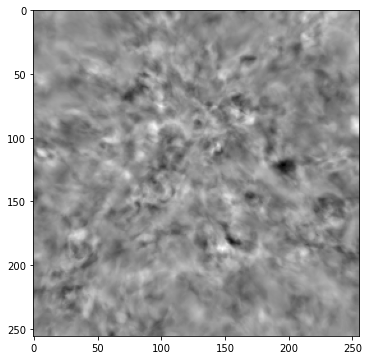

Step 1000, Total loss 0.0010433447314426303
Max: 1.0180482864379883, Min: -0.052782028913497925
PSNR: 27.61446237564087


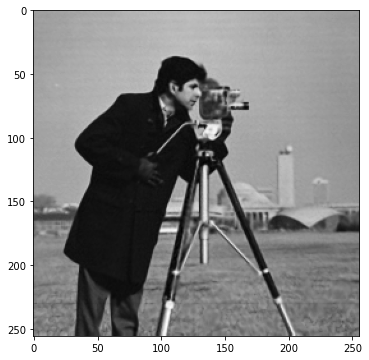

Step 2000, Total loss 0.00042722088983282447
Max: 1.0463563203811646, Min: -0.05435797572135925
PSNR: 29.721596240997314


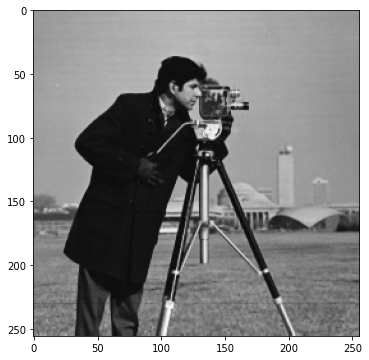

Step 3000, Total loss 0.0002209368540206924
Max: 1.015764594078064, Min: -0.0452766939997673
PSNR: 31.56348466873169


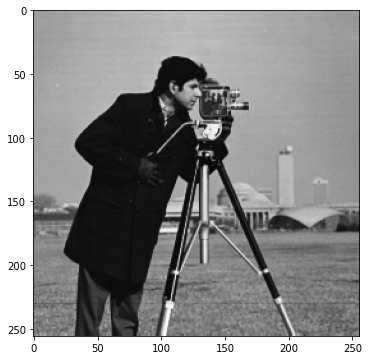

Step 4000, Total loss 0.00014293345157057047
Max: 1.0001391172409058, Min: -0.06389248371124268
PSNR: 28.48184108734131


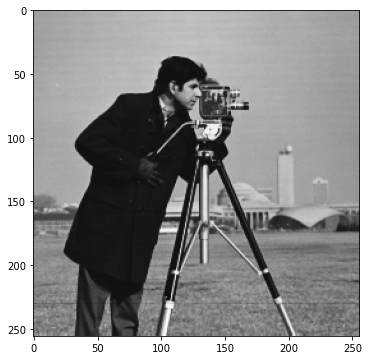

Step 5000, Total loss 0.00011598557466641068
Max: 1.0207130908966064, Min: -0.0803605392575264
PSNR: 27.885231971740723


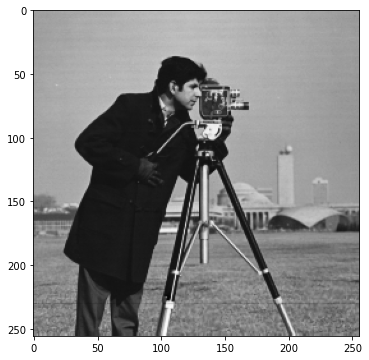

Step 6000, Total loss 7.603588892379776e-05
Max: 1.0144305229187012, Min: -0.04501564800739288
PSNR: 32.447826862335205


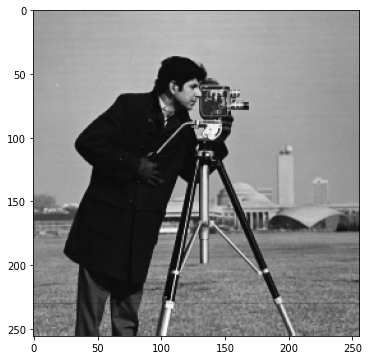

Step 7000, Total loss 7.946373079903424e-05
Max: 1.0229671001434326, Min: -0.02709633857011795
PSNR: 36.04344606399536


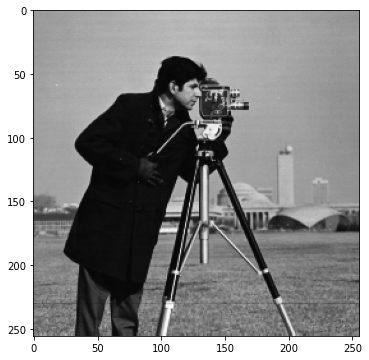

Step 8000, Total loss 6.590841803699732e-05
Max: 1.008100986480713, Min: -0.030263565480709076
PSNR: 35.01840829849243


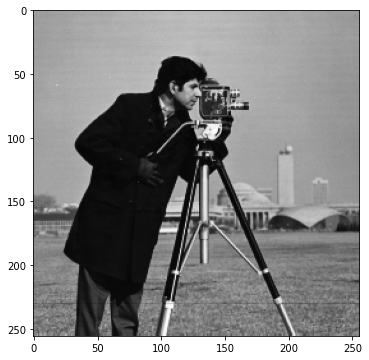

Step 9000, Total loss 4.2078860133187845e-05
Max: 1.007938027381897, Min: -0.0061050280928611755
PSNR: 42.637834548950195


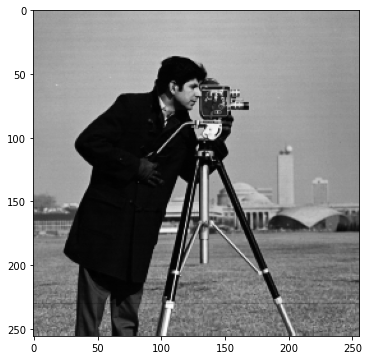

Step 10000, Total loss 5.3009331168141216e-05
Max: 1.001621127128601, Min: -0.09421086311340332
PSNR: 25.898165702819824


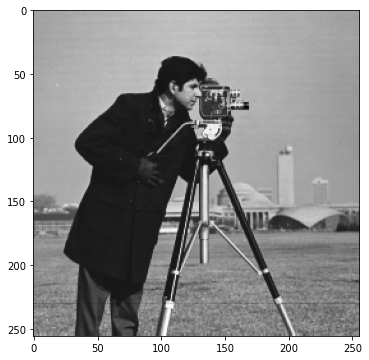

Step 11000, Total loss 7.690136408200487e-05
Max: 1.007847547531128, Min: -0.00843288004398346
PSNR: 40.297555923461914


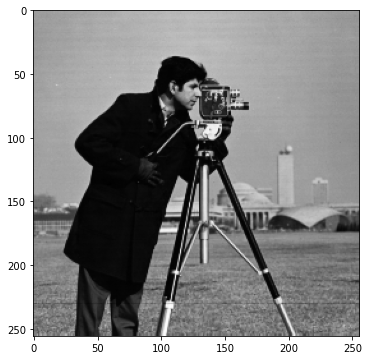

Step 12000, Total loss 2.4244876840384677e-05
Max: 0.9997565746307373, Min: -0.003204401582479477
PSNR: 45.678133964538574


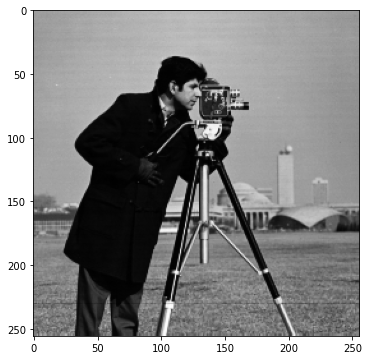

Step 13000, Total loss 2.074071380775422e-05
Max: 1.0014790296554565, Min: -0.0008501261472702026
PSNR: 46.642818450927734


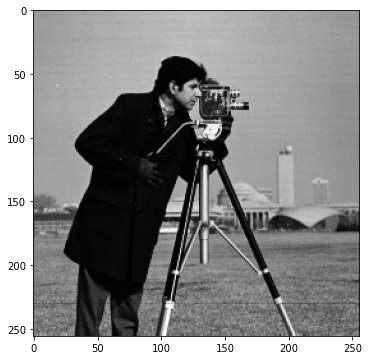

Step 14000, Total loss 4.183397686574608e-05
Max: 1.0012531280517578, Min: -0.00766005739569664
PSNR: 42.45593547821045


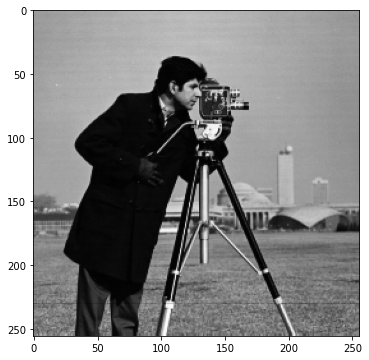

Step 15000, Total loss 2.6880383302341215e-05
Max: 0.9968833923339844, Min: -0.011782724410295486
PSNR: 40.378122329711914


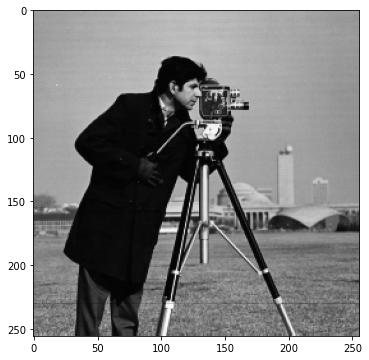

Step 16000, Total loss 1.6239831893472e-05
Max: 1.0015517473220825, Min: -0.0022383220493793488
PSNR: 47.5830078125


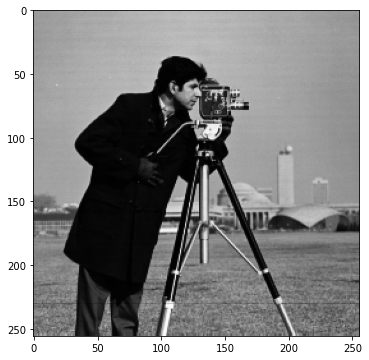

Step 17000, Total loss 3.3676096791168675e-05
Max: 1.0121653079986572, Min: -0.014152411371469498
PSNR: 40.95590591430664


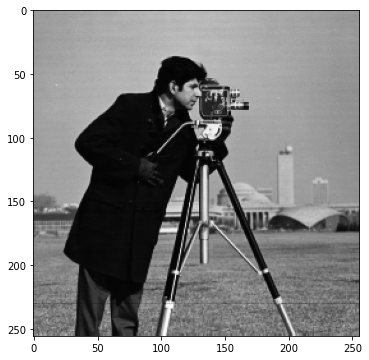

Step 18000, Total loss 3.247629865654744e-05
Max: 1.0177102088928223, Min: -0.026720624417066574
PSNR: 37.011616230010986


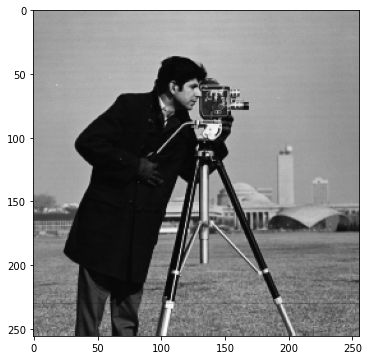

Step 19000, Total loss 1.325366974924691e-05
Max: 0.9947747588157654, Min: -0.0015041530132293701
PSNR: 46.03466510772705


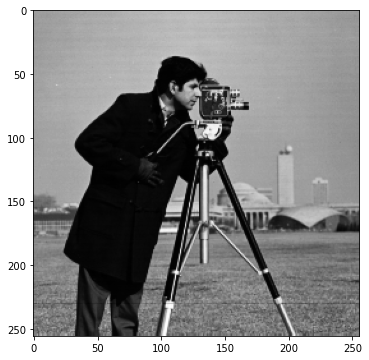

Step 20000, Total loss 1.1246016583754681e-05
Max: 1.0004671812057495, Min: -0.002266921103000641
PSNR: 48.771042823791504


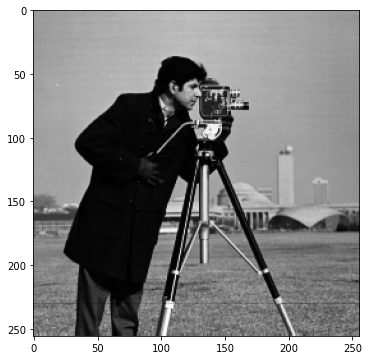

Step 21000, Total loss 2.1677369659300894e-05
Max: 0.992568850517273, Min: -0.011539757251739502
PSNR: 40.58421611785889


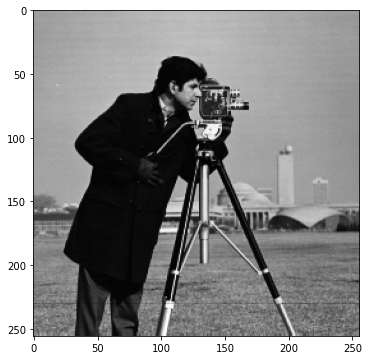

Step 22000, Total loss 8.80479819898028e-06
Max: 1.0020861625671387, Min: -0.0003562234342098236
PSNR: 50.22663593292236


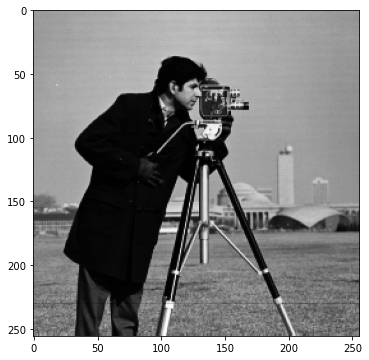

Step 23000, Total loss 9.233588571078144e-06
Max: 0.9990053772926331, Min: -0.0012997351586818695
PSNR: 50.08433818817139


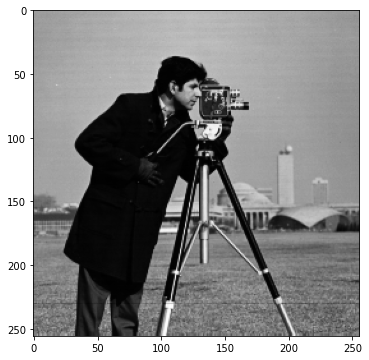

Step 24000, Total loss 1.6590960512985475e-05
Max: 1.0001057386398315, Min: -0.005017910152673721
PSNR: 45.63451290130615


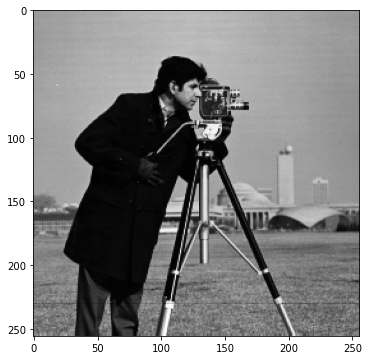

Step 25000, Total loss 1.630541737540625e-05
Max: 1.008107304573059, Min: -0.002120044082403183
PSNR: 45.74531555175781


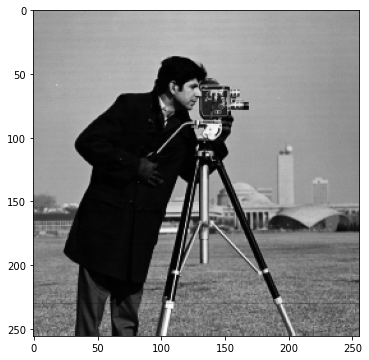

Step 26000, Total loss 2.609735747682862e-05
Max: 1.0031262636184692, Min: -0.00441732257604599
PSNR: 45.06128787994385


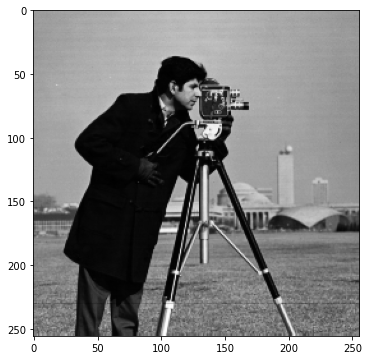

Step 27000, Total loss 8.134020390571095e-06
Max: 1.0010863542556763, Min: -0.0023899823427200317
PSNR: 50.18136024475098


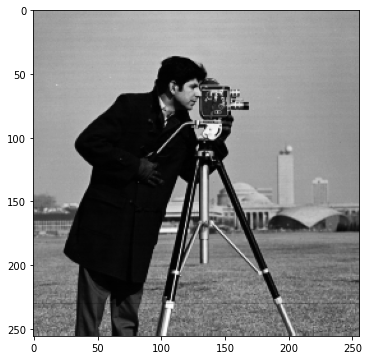

Step 28000, Total loss 6.273805411183275e-06
Max: 1.001375436782837, Min: -0.00026694685220718384
PSNR: 51.86293125152588


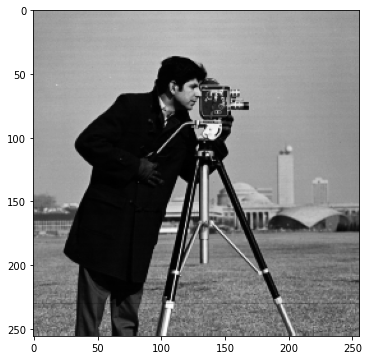

Step 29000, Total loss 9.48271008383017e-06
Max: 1.0020434856414795, Min: -0.004946328699588776
PSNR: 48.005404472351074


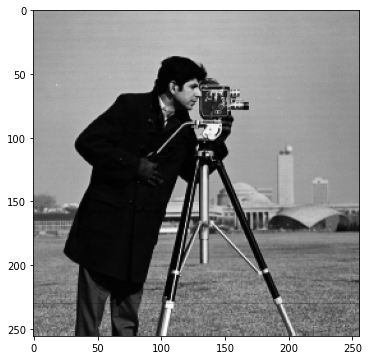

Step 30000, Total loss 9.908461834129412e-06
Max: 0.9989594221115112, Min: -0.006287477910518646
PSNR: 45.753421783447266


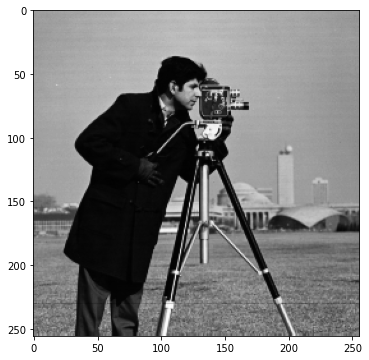

Step 31000, Total loss 4.241192982590292e-06
Max: 0.9999749064445496, Min: -0.000135030597448349
PSNR: 53.7156343460083


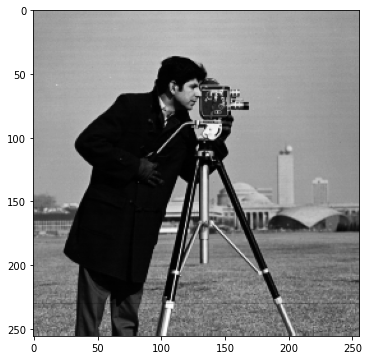

Step 32000, Total loss 5.881089236936532e-06
Max: 1.0007065534591675, Min: -0.00838189572095871
PSNR: 45.43198108673096


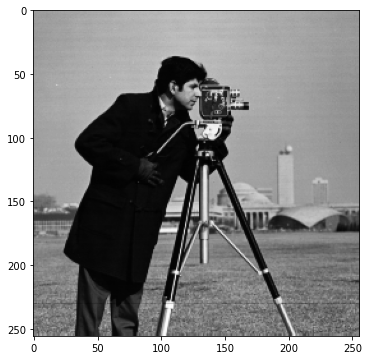

Step 33000, Total loss 6.340427717077546e-06
Max: 1.0007245540618896, Min: -0.003354877233505249
PSNR: 50.27919292449951


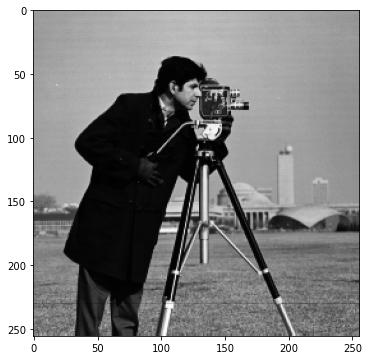

Step 34000, Total loss 4.1685838368721306e-05
Max: 1.036529779434204, Min: -0.008654177188873291
PSNR: 36.78706884384155


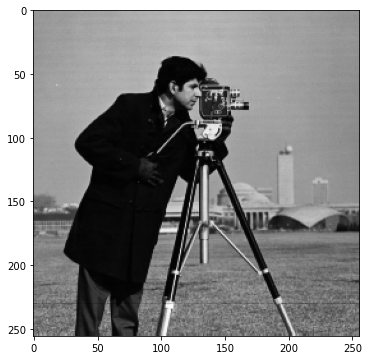

Step 35000, Total loss 6.694148396491073e-06
Max: 1.0009114742279053, Min: -0.002529062330722809
PSNR: 50.81789016723633


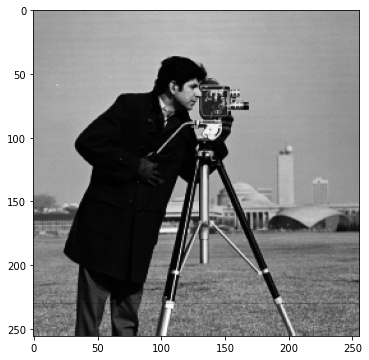

Step 36000, Total loss 3.7481386243598536e-06
Max: 1.0005507469177246, Min: 0.0002458915114402771
PSNR: 54.24732685089111


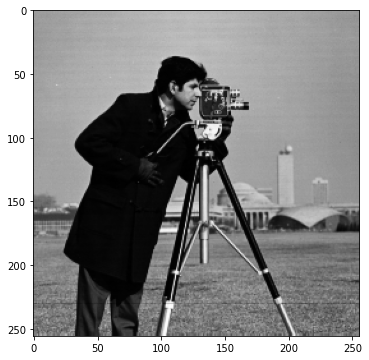

Step 37000, Total loss 3.891771939379396e-06
Max: 0.9999704957008362, Min: -0.0008522272109985352
PSNR: 53.832926750183105


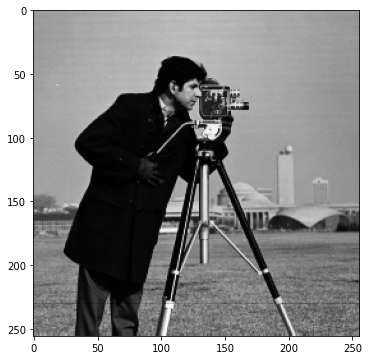

Step 38000, Total loss 3.704021764860954e-06
Max: 1.0017544031143188, Min: -0.0010474994778633118
PSNR: 54.32344913482666


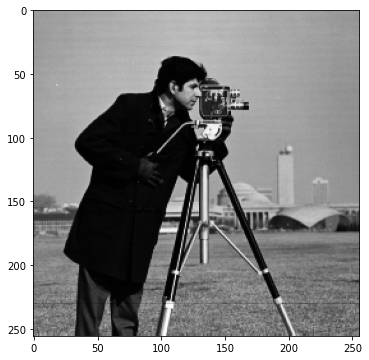

Step 39000, Total loss 4.155100214120466e-06
Max: 1.00087308883667, Min: 0.00015089288353919983
PSNR: 52.77022361755371


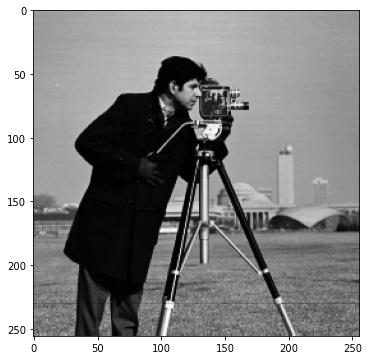

Step 40000, Total loss 2.953686816908885e-06
Max: 1.0000368356704712, Min: -0.0020903795957565308
PSNR: 53.358330726623535


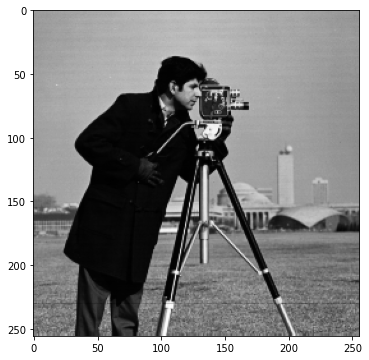

Step 41000, Total loss 3.1973452223610366e-06
Max: 1.0001678466796875, Min: -0.00025532767176628113
PSNR: 54.95110034942627


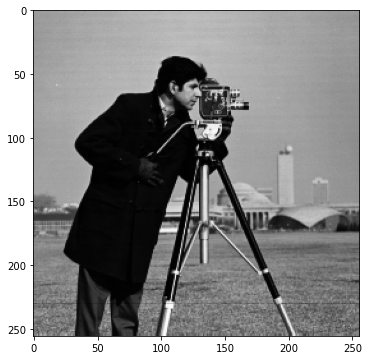

Step 42000, Total loss 1.6893758584046736e-05
Max: 1.0052587985992432, Min: -0.010518878698348999
PSNR: 43.32690238952637


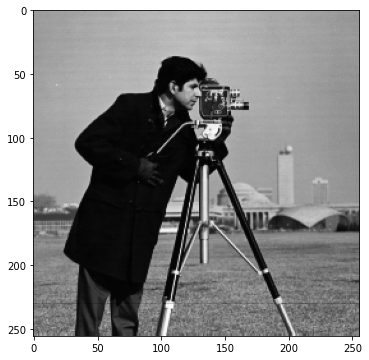

Step 43000, Total loss 2.9202346922829747e-06
Max: 1.0012035369873047, Min: -0.0006876140832901001
PSNR: 54.967002868652344


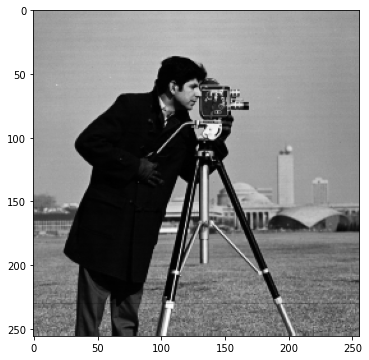

Step 44000, Total loss 1.0589339581201784e-05
Max: 1.002221703529358, Min: -0.0010725073516368866
PSNR: 50.22495746612549


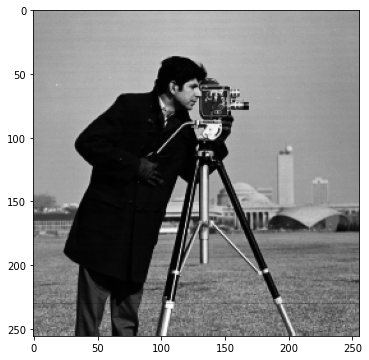

Step 45000, Total loss 1.595225512573961e-05
Max: 1.0046151876449585, Min: -0.0073130205273628235
PSNR: 45.179691314697266


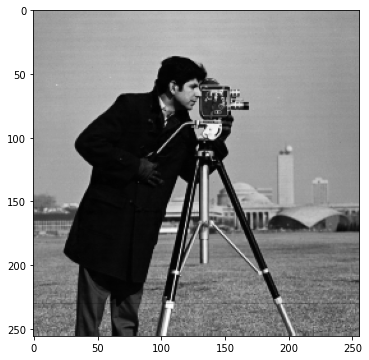

Step 46000, Total loss 1.6319763744832017e-06
Max: 0.9999192357063293, Min: -0.000327330082654953
PSNR: 57.666358947753906


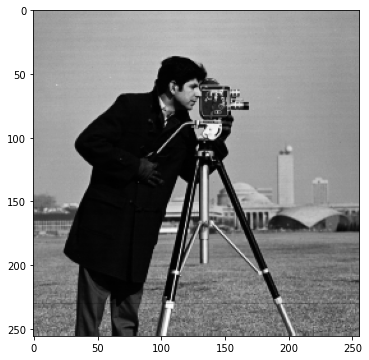

Step 47000, Total loss 2.4332587145181606e-06
Max: 1.0000660419464111, Min: -0.0015572309494018555
PSNR: 54.67409610748291


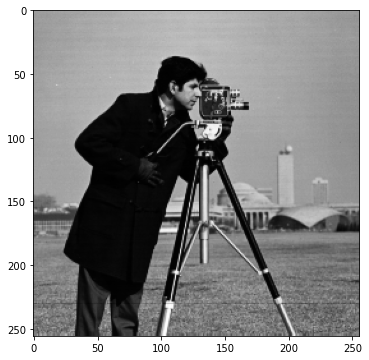

Step 48000, Total loss 1.894691649795277e-06
Max: 1.000786304473877, Min: -0.0007018148899078369
PSNR: 56.890859603881836


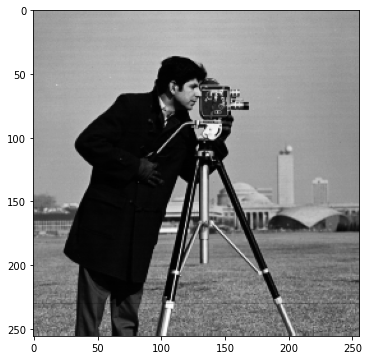

Step 49000, Total loss 7.014582024567062e-06
Max: 1.004021406173706, Min: -0.004678018391132355
PSNR: 49.51335906982422


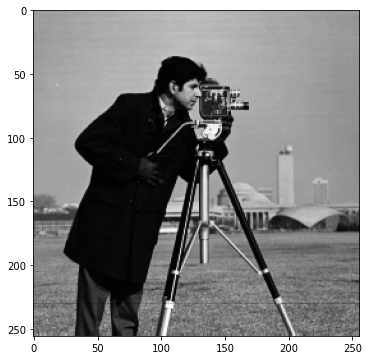

Step 50000, Total loss 2.8597837626875844e-06
Max: 1.0011861324310303, Min: -0.0032853707671165466
PSNR: 52.448744773864746


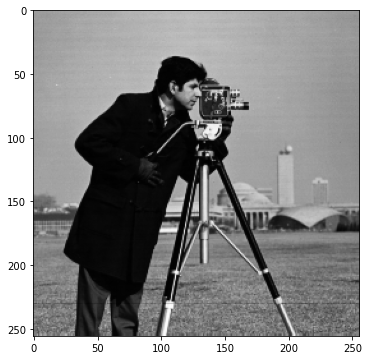

Step 51000, Total loss 4.594875917973695e-06
Max: 1.0014852285385132, Min: -0.000979602336883545
PSNR: 53.106632232666016


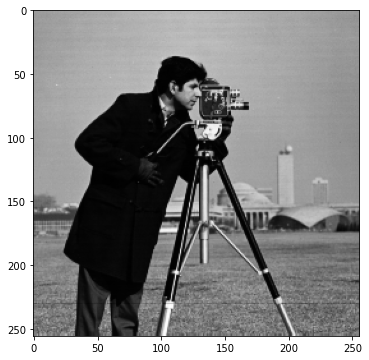

Step 52000, Total loss 4.6492714318446815e-06
Max: 1.0021905899047852, Min: -0.0011665374040603638
PSNR: 53.001370429992676


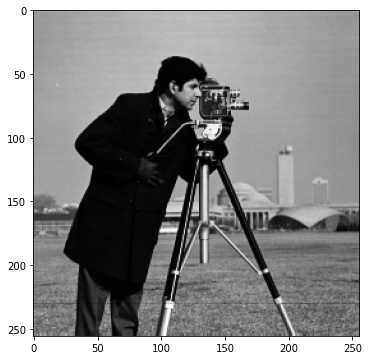

Step 53000, Total loss 1.6001799849618692e-06
Max: 1.0007965564727783, Min: 2.2202730178833008e-05
PSNR: 58.06330680847168


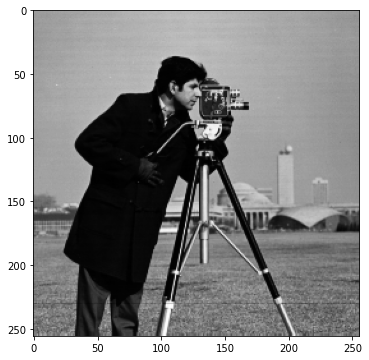

Step 54000, Total loss 1.5485686162719503e-05
Max: 1.0017390251159668, Min: -0.009339619427919388
PSNR: 43.13985347747803


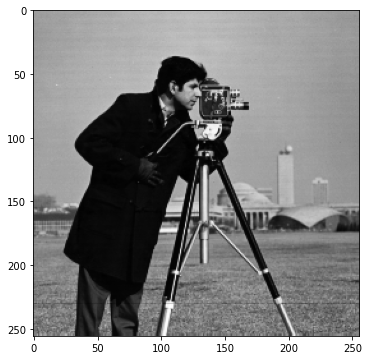

Step 55000, Total loss 5.8157402236247435e-06
Max: 0.9999262094497681, Min: -0.010386694222688675
PSNR: 43.22500705718994


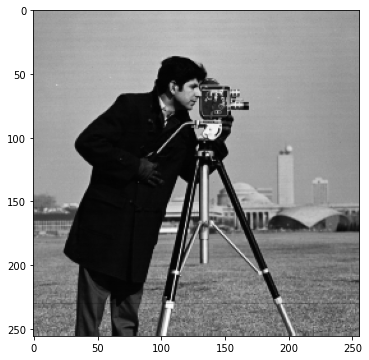

Step 56000, Total loss 2.72204101747775e-06
Max: 0.9999284148216248, Min: -0.0010736174881458282
PSNR: 54.21183109283447


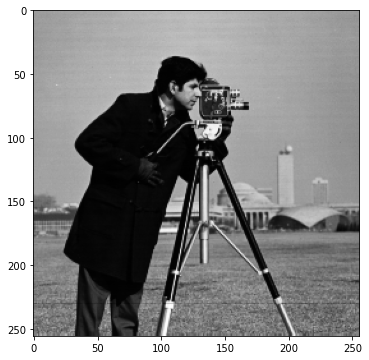

Step 57000, Total loss 2.0607046735676704e-06
Max: 1.0000702142715454, Min: -0.0029986798763275146
PSNR: 52.652692794799805


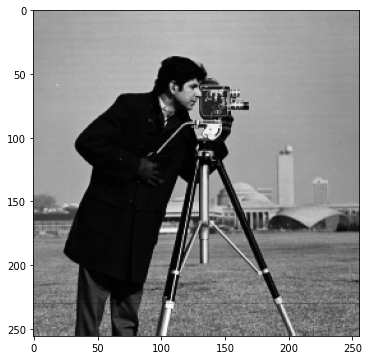

Step 58000, Total loss 8.506908670824487e-07
Max: 1.000508189201355, Min: -0.000370759516954422
PSNR: 60.40315628051758


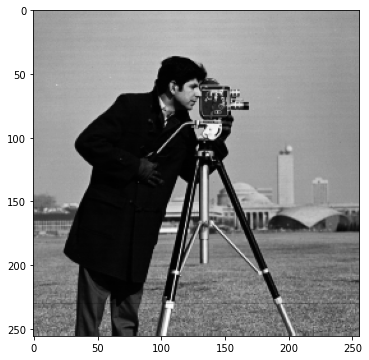

Step 59000, Total loss 1.6942281035881024e-06
Max: 0.9986354112625122, Min: -0.0006601624190807343
PSNR: 55.09648323059082


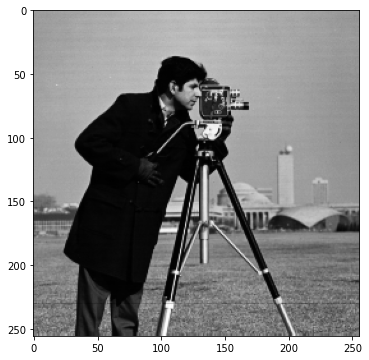

Step 60000, Total loss 9.576810953149106e-07
Max: 1.0004762411117554, Min: 0.00017962977290153503
PSNR: 59.777541160583496


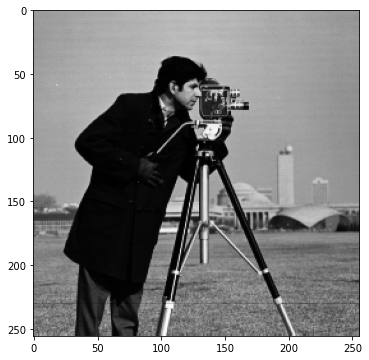

Step 61000, Total loss 1.5136465663090348e-06
Max: 1.0004950761795044, Min: -0.0006545707583427429
PSNR: 57.92864799499512


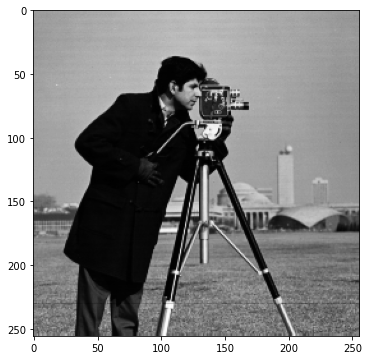

Step 62000, Total loss 3.4918318760901457e-06
Max: 1.0018856525421143, Min: -0.0013797692954540253
PSNR: 53.7188196182251


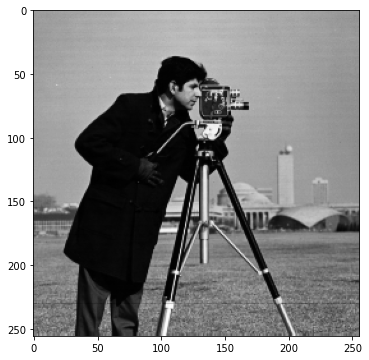

Step 63000, Total loss 1.078145714927814e-06
Max: 1.0007425546646118, Min: -0.0003221258521080017
PSNR: 59.285340309143066


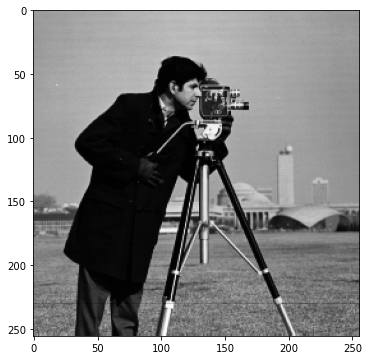

Step 64000, Total loss 8.706597327545751e-07
Max: 0.9997170567512512, Min: -0.00045517832040786743
PSNR: 59.52218055725098


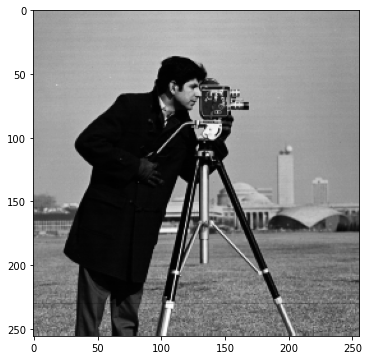

Step 65000, Total loss 6.650165573773847e-07
Max: 1.0007140636444092, Min: -0.000385187566280365
PSNR: 61.43220901489258


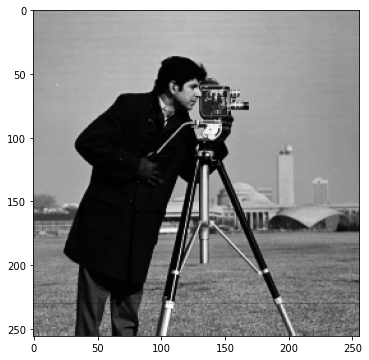

Step 66000, Total loss 2.7155469979334157e-06
Max: 0.9981696009635925, Min: -0.0031226128339767456
PSNR: 50.88189125061035


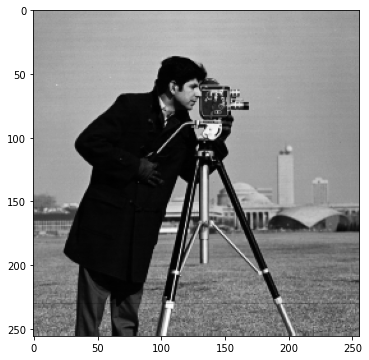

Step 67000, Total loss 1.0443159226269927e-06
Max: 1.0010027885437012, Min: -0.0015904419124126434
PSNR: 57.829389572143555


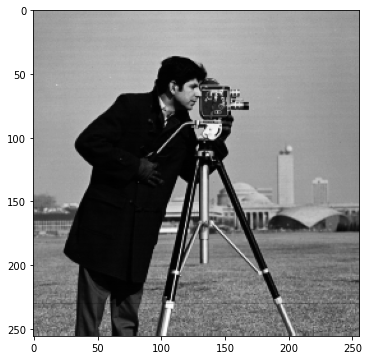

Step 68000, Total loss 1.8414532405586215e-06
Max: 1.0011553764343262, Min: -0.0014488138258457184
PSNR: 56.34943962097168


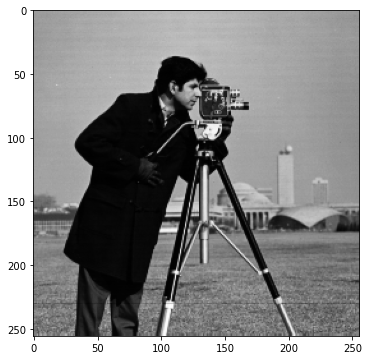

Step 69000, Total loss 1.6612582385278074e-06
Max: 1.0004303455352783, Min: 2.9806047677993774e-05
PSNR: 58.22807312011719


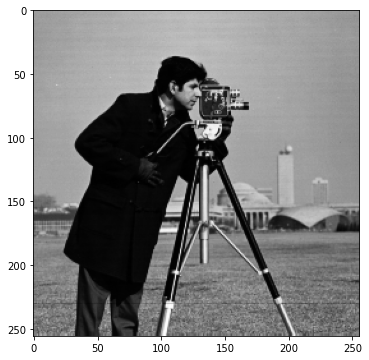

Step 70000, Total loss 1.239972107214271e-06
Max: 0.9992573261260986, Min: -0.0013233870267868042
PSNR: 56.052374839782715


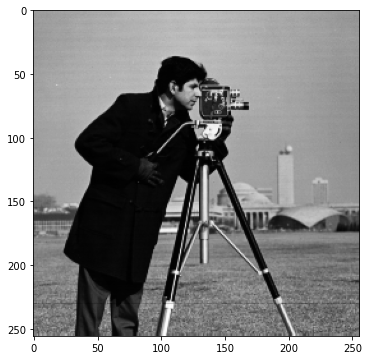

Step 71000, Total loss 9.911153711072984e-07
Max: 1.0006225109100342, Min: -0.00014597177505493164
PSNR: 59.57343578338623


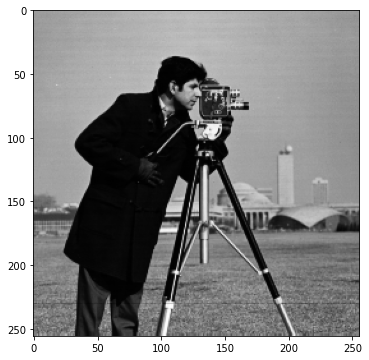

Step 72000, Total loss 9.351419976155739e-07
Max: 1.0015594959259033, Min: -0.0001568533480167389
PSNR: 57.92994976043701


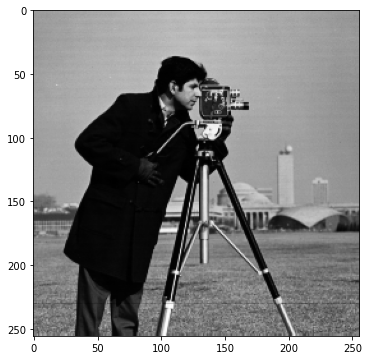

In [ ]:
niters = 100000 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 1000

optim = torch.optim.Adam(lr=5e-4, params=model_bw_relu.parameters())
scheduler = LambdaLR(optim, lambda x: 0.1**min(x/niters, 1))

loss_bw_relu = []

for step in range(niters):
    
    model_output = model_bw_relu(coords)
    loss = ((img_tensor - model_output.squeeze(dim=2)) ** 2).mean()
    loss_bw_relu.append(loss.item())
    
    if not step % steps_til_summary:
        print("Step {}, Total loss {}".format(step, loss))

        fig = plt.figure(figsize=(6,6))
        print('Max: {}, Min: {}'.format(torch.max(model_output), torch.min(model_output)))
        
        model_out_np = model_output.cpu().view(256,256).detach().numpy()
        mod_out_normed = (model_out_np - np.min(model_out_np))/np.ptp(model_out_np)

        loss_normed = ((image - mod_out_normed) ** 2).mean()
        print('PSNR: {}'.format(-10*np.log10(loss_normed)))
        
        plt.imshow(mod_out_normed, vmin=0, vmax=1, cmap='gray')
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()
    scheduler.step()

### Hooks

In [7]:
model_bw_relu

INR(
  (net): Sequential(
    (0): BsplineWaveletLayer(
      (block): Sequential(
        (linear): Linear(in_features=2, out_features=300, bias=True)
        (bspline_w): BSplineWavelet()
      )
    )
    (1): BsplineWaveletLayer(
      (block): Sequential(
        (linear): Linear(in_features=300, out_features=300, bias=True)
        (bspline_w): BSplineWavelet()
      )
    )
    (2): BsplineWaveletLayer(
      (block): Sequential(
        (linear): Linear(in_features=300, out_features=300, bias=True)
        (bspline_w): BSplineWavelet()
        (linear2): Linear(in_features=300, out_features=1, bias=True)
      )
    )
  )
)

In [8]:
lin_outs_bw_relu = []

# Define a hook
def hook_fn(m, input, output):
    print('Hookin')
    lin_outs_bw_relu.append(output)

# Register the hook to get output from the 1st linear layer
first_lin = model_bw_relu.net[0].block.linear.register_forward_hook(hook_fn)

# Register the hook to get output from the 2nd linear layer
second_lin = model_bw_relu.net[1].block.linear.register_forward_hook(hook_fn)

# Register the hook to get output from the 3rd linear layer
third_lin = model_bw_relu.net[2].block.linear.register_forward_hook(hook_fn)

In [9]:
out = model_bw_relu(coords)

Hookin
Hookin
Hookin


In [10]:
len(lin_outs_bw_relu)

3

In [11]:
first_lin_out = lin_outs_bw_relu[0]
second_lin_out = lin_outs_bw_relu[1]
third_lin_out = lin_outs_bw_relu[2]

In [12]:
first_lin_out.shape

torch.Size([1, 65536, 300])

In [13]:
def bspline_wavelet_pieces(x, scale):
    relu_one = (1 / 6) * F.relu(scale*x)
    relu_two = - (8 / 6) * F.relu(scale*x - (1 / 2))
    relu_three = (23 / 6) * F.relu(scale*x - (1))
    relu_four = - (16 / 3) * F.relu(scale*x - (3 / 2))
    relu_five = (23 / 6) * F.relu(scale*x - (2))
    relu_six = - (8 / 6) * F.relu(scale*x - (5 / 2))
    relu_seven = (1 / 6) * F.relu(scale*x - (3))

    all = relu_one + relu_two + relu_three + relu_four + relu_five + relu_six + relu_seven
    
    return all, relu_one, relu_two, relu_three, relu_four, relu_five, relu_six, relu_seven

#### Activation patterns for 1st layer

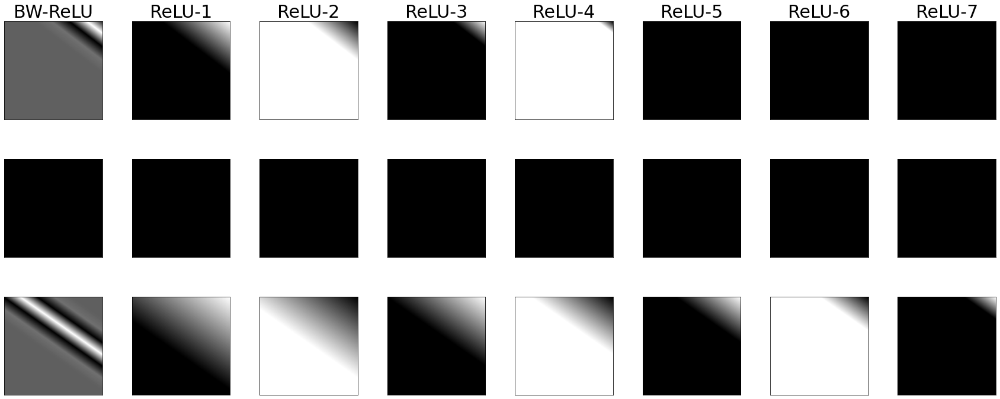

In [14]:
first_layer_neurons = first_lin_out.squeeze().T

# Number of randomly choosen neurons
k = 3

perm = torch.randperm(first_layer_neurons.shape[0])
idx = perm[:k]
# print('Plotting neurons {}'.format(idx))
samples = first_layer_neurons[idx]

fig, axs = plt.subplots(k, 8, figsize=(30,30), gridspec_kw={'hspace': -0.8, 'wspace': 0.3})
eps = 1e-8

for i, neuron in enumerate(samples):
    neuron_img = neuron.detach().cpu().reshape((256,256))

    bw_relu_neuron, *relu_neurons = bspline_wavelet_pieces(neuron_img, 3)

    bw_relu_neuron_np = bw_relu_neuron.numpy()
    bw_relu_relu_neuron_normed = (bw_relu_neuron_np - np.min(bw_relu_neuron_np))/(np.ptp(bw_relu_neuron_np)+eps)
    bw_relu_neuron_plot = axs[i,0].imshow(bw_relu_relu_neuron_normed, vmin=0, vmax=1, cmap='gray')
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    
    if i==0:
        axs[i,0].set_title('BW-ReLU', fontsize=30)
    
    for j,relu_neuron in enumerate(relu_neurons):
        relu_neuron_np = relu_neuron.numpy()
        
        relu_neuron_normed = (relu_neuron_np - np.min(relu_neuron_np))/(np.ptp(relu_neuron_np)+eps)
        relu_neuron_plot = axs[i,j+1].imshow(relu_neuron_normed, vmin=0, vmax=1, cmap='gray')
        if i==0:
            axs[i,j+1].set_title('ReLU-{}'.format(j+1), fontsize=30)
        # Remove tick marks
        axs[i,j+1].set_xticks([])
        axs[i,j+1].set_yticks([])

#plt.savefig('results/first_lin_layer_signal_rep.pdf', bbox_inches='tight', dpi=500)
plt.show()

# Add colorbars
# fig.colorbar(deep_act, ax=axs[i])

#### Activation Patterns 2nd Layer

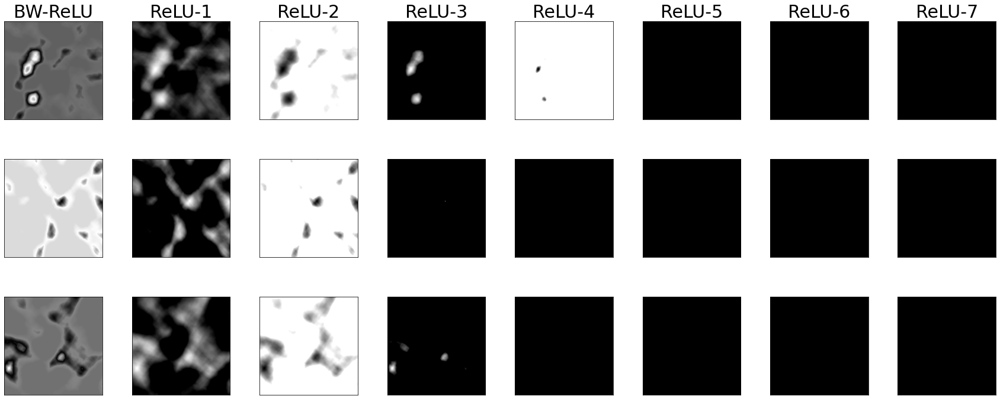

In [15]:
second_layer_neurons = second_lin_out.squeeze().T

# # Number of subsamples
k = 3

perm = torch.randperm(second_layer_neurons.shape[0])
idx = perm[:k]
# print('Plotting neurons {}'.format(idx))
samples = second_layer_neurons[idx]

fig, axs = plt.subplots(k, 8, figsize=(30,30), gridspec_kw={'hspace': -0.8, 'wspace': 0.3})
eps = 1e-8

for i, neuron in enumerate(samples):
    neuron_img = neuron.detach().cpu().reshape((256,256))

    bw_relu_neuron, *relu_neurons = bspline_wavelet_pieces(neuron_img, 3)

    bw_relu_neuron_np = bw_relu_neuron.numpy()
    bw_relu_relu_neuron_normed = (bw_relu_neuron_np - np.min(bw_relu_neuron_np))/(np.ptp(bw_relu_neuron_np)+eps)
    bw_relu_neuron_plot = axs[i,0].imshow(bw_relu_relu_neuron_normed, vmin=0, vmax=1, cmap='gray')
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    
    if i==0:
        axs[i,0].set_title('BW-ReLU', fontsize=30)
    
    for j,relu_neuron in enumerate(relu_neurons):
        relu_neuron_np = relu_neuron.numpy()
        
        relu_neuron_normed = (relu_neuron_np - np.min(relu_neuron_np))/(np.ptp(relu_neuron_np)+eps)
        relu_neuron_plot = axs[i,j+1].imshow(relu_neuron_normed, vmin=0, vmax=1, cmap='gray')
        if i==0:
            axs[i,j+1].set_title('ReLU-{}'.format(j+1), fontsize=30)
        # Remove tick marks
        axs[i,j+1].set_xticks([])
        axs[i,j+1].set_yticks([])
        
#plt.savefig('results/second_lin_layer_signal_rep.pdf', bbox_inches='tight', dpi=500)
plt.show()

# Add colorbars
# fig.colorbar(deep_act, ax=axs[i])

#### Activation Patterns 3rd Layer

In [ ]:
third_layer_neurons = third_lin_out.squeeze().T

# # Number of subsamples
k = 3

perm = torch.randperm(third_layer_neurons.shape[0])
idx = perm[:k]
# print('Plotting neurons {}'.format(idx))
samples = third_layer_neurons[idx]

fig, axs = plt.subplots(k, 8, figsize=(30,30), gridspec_kw={'hspace': -0.8, 'wspace': 0.3})
eps = 1e-8

for i, neuron in enumerate(samples):
    neuron_img = neuron.detach().cpu().reshape((256,256))

    bw_relu_neuron, *relu_neurons = bspline_wavelet_pieces(neuron_img, 3)

    bw_relu_neuron_np = bw_relu_neuron.numpy()
    bw_relu_relu_neuron_normed = (bw_relu_neuron_np - np.min(bw_relu_neuron_np))/(np.ptp(bw_relu_neuron_np)+eps)
    bw_relu_neuron_plot = axs[i,0].imshow(bw_relu_relu_neuron_normed, vmin=0, vmax=1, cmap='gray')
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    
    if i==0:
        axs[i,0].set_title('BW-ReLU', fontsize=30)
    
    for j,relu_neuron in enumerate(relu_neurons):
        relu_neuron_np = relu_neuron.numpy()
        
        relu_neuron_normed = (relu_neuron_np - np.min(relu_neuron_np))/(np.ptp(relu_neuron_np)+eps)
        relu_neuron_plot = axs[i,j+1].imshow(relu_neuron_normed, vmin=0, vmax=1, cmap='gray')
        if i==0:
            axs[i,j+1].set_title('ReLU-{}'.format(j+1), fontsize=30)
        # Remove tick marks
        axs[i,j+1].set_xticks([])
        axs[i,j+1].set_yticks([])

#plt.savefig('results/third_lin_layer_signal_rep.pdf', bbox_inches='tight', dpi=500)
plt.show()

# Add colorbars
# fig.colorbar(deep_act, ax=axs[i])

In [15]:
vals_bspline_1, indx_bspline_1 = big_contribs(deep_neurons, model_bw_relu.net[2].block.linear2)

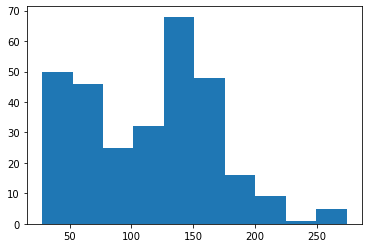

In [16]:
plt.hist(vals_bspline_1.detach().cpu())
plt.show()

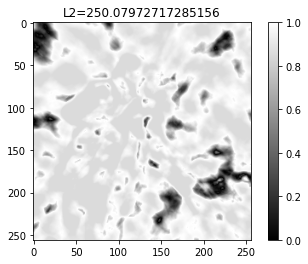

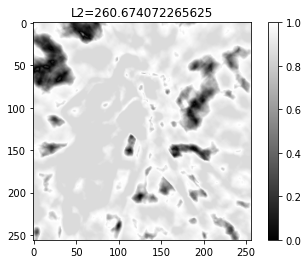

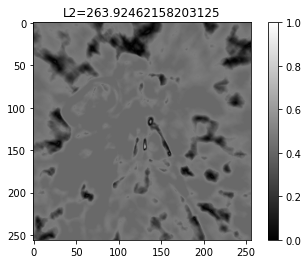

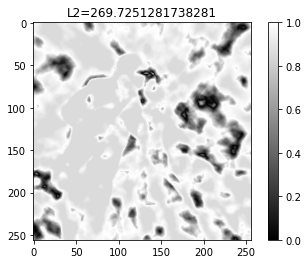

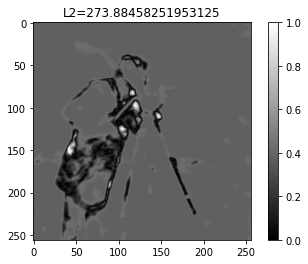

In [17]:
big_atoms = deep_neurons[indx_bspline_1[vals_bspline_1.detach().cpu() > 250]]
big_vals = vals_bspline_1[vals_bspline_1.detach().cpu() > 250]

for atom,L2_val in zip(big_atoms, big_vals):
    atom_np = atom.detach().cpu().reshape((256,256)).numpy()
    atom_normed_np = (atom_np - np.min(atom_np))/np.ptp(atom_np)
    
    plt.imshow(atom_normed_np, vmin=0, vmax=1, cmap='gray')
    plt.colorbar()
    plt.title('L2={}'.format(torch.linalg.norm(L2_val)))
    plt.show()

## SIREN Experiments 

In [5]:
device = 'cuda:0'
torch.manual_seed(40)
model_siren = models.get_INR(
            nonlin='siren',
            in_features=2,
            out_features=1, 
            hidden_features=300,
            hidden_layers=3,
            first_omega_0=50,
            hidden_omega_0=50)

model_siren.to(device)

INR(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=300, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=300, out_features=300, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=300, out_features=300, bias=True)
    )
    (3): Linear(in_features=300, out_features=1, bias=True)
  )
)

In [6]:
## Load pretrained model with omega_0=50 and 104 dB

model_siren.load_state_dict\
(torch.load('results/signal_representation/siren_c_1.0_omega_50.0_sigma_10_lr_0.002_lam_0_PN_None_width_300_layers_3_lin_None_epochs_1000_seed_40_0412_1052/model.pt'))

<All keys matched successfully>

In [71]:
%run exp_signal_representation -af='siren' --c=1 --omega0=20 --lr=0.002 --layers=3 --epochs=1000 

siren
INR(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=300, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=300, out_features=300, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=300, out_features=300, bias=True)
    )
    (3): Linear(in_features=300, out_features=1, bias=True)
  )
)


PSNR: 31.007, Loss DNN: 2.529e-04: 100%|██████████| 1000/1000 [00:20<00:00, 49.77it/s]


<Figure size 432x288 with 0 Axes>

In [72]:
model

INR(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=300, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=300, out_features=300, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=300, out_features=300, bias=True)
    )
    (3): Linear(in_features=300, out_features=1, bias=True)
  )
)

In [73]:
deep_act_funcs_siren = []

# Define a hook
def hook_fn(m, i, o):
    print('Hookin')
    deep_act_funcs_siren.append(o)

# Register the hook to get output after the 1st SIREN layer
first_lin = model.net[0].register_forward_hook(hook_fn)

# Register the hook to get output after the 2nd SIREN layer
second_lin = model.net[1].register_forward_hook(hook_fn)

# Register the hook to get output after the 3rd linear SIREN layer
third_lin = model.net[2].register_forward_hook(hook_fn)

In [74]:
out = model(coords)

Hookin
Hookin
Hookin


Plotting neurons SIREN tensor([160, 136, 126])


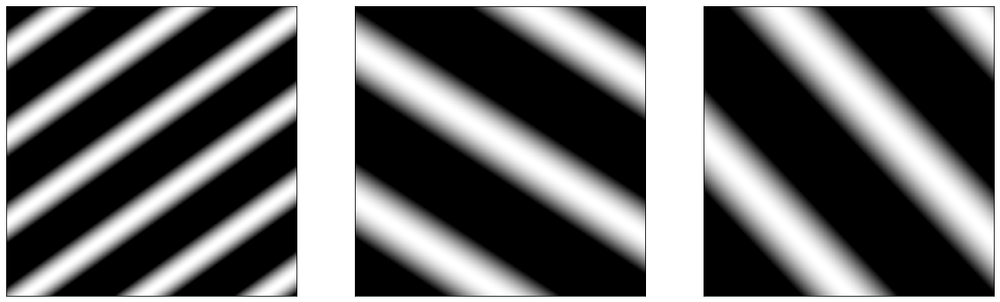

In [75]:
deep_neurons_siren_1 = deep_act_funcs_siren[0].T

# Number of subsamples
k = 3


perm = torch.randperm(deep_neurons_siren_1.size(0))
idx = perm[:k]
print('Plotting neurons SIREN {}'.format(idx))
samples = deep_neurons_siren_1[idx]

fig, axs = plt.subplots(1,k, figsize=(20,20))

for i,neuron in enumerate(samples):
    deep_act = axs[i].imshow(neuron.detach().cpu().reshape((256,256)), vmin=0, vmax=1, cmap='gray')
    
    # Remove tick marks
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    
# Add colorbars
plt.show()

Plotting neurons tensor([184, 130,  72])


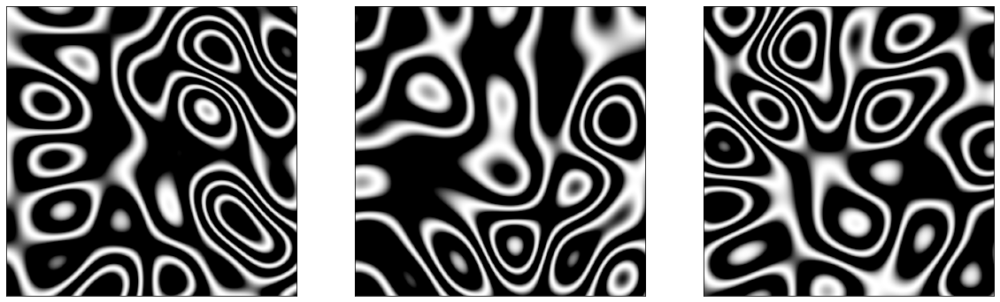

In [76]:
deep_neurons_siren_2 = deep_act_funcs_siren[1].T

# Number of subsamples
k = 3


perm = torch.randperm(deep_neurons_siren_2.size(0))
idx = perm[:k]
print('Plotting neurons {}'.format(idx))
samples = deep_neurons_siren_2[idx]

fig, axs = plt.subplots(1,k, figsize=(20,20))

for i,neuron in enumerate(samples):
    deep_act = axs[i].imshow(neuron.detach().cpu().reshape((256,256)), vmin=0, vmax=1, cmap='gray')
    
    # Remove tick marks
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    
# Add colorbars
plt.show()

Plotting neurons tensor([184, 130,  72])


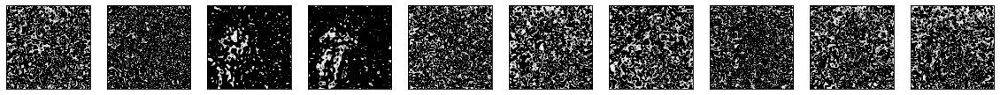

In [80]:
deep_neurons_siren_3 = deep_act_funcs_siren[2].T

# Number of subsamples
k = 10


# perm = torch.randperm(deep_neurons_siren_3.size(0))
# idx = perm[:k]
print('Plotting neurons {}'.format(idx))
samples = deep_neurons_siren_3[131:141]

fig, axs = plt.subplots(1,k, figsize=(20,20))

for i,neuron in enumerate(samples):
    deep_act = axs[i].imshow(neuron.detach().cpu().reshape((256,256)), vmin=0, vmax=1, cmap='gray')
    
    # Remove tick marks
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    
# Add colorbars
plt.show()

Plotting neurons tensor([188,  91, 142, 155,  86,  73,  34, 196, 290,  59,  25,  88,   9, 156,
        148, 231, 152, 264,  50, 119, 189, 105,  82,  23,   3, 101, 171, 254,
        237, 113, 263, 234,  51, 146, 154, 141,  18,  40, 280,  95,  68, 257,
         52, 127,  96, 204, 233, 121, 173, 182])


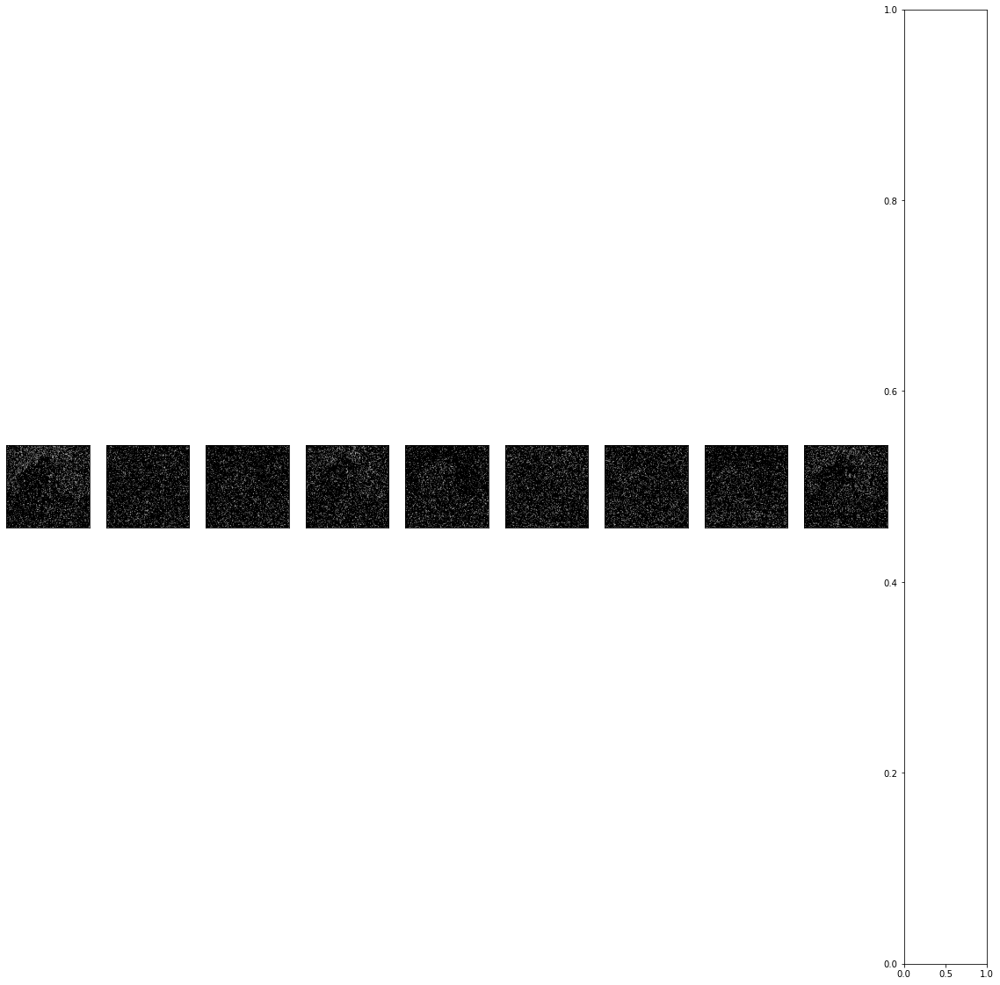

In [54]:
deep_neurons_siren_3 = deep_act_funcs_siren[2].T

# Number of subsamples
k = 10


# perm = torch.randperm(deep_neurons_siren_3.size(0))
# idx = perm[:k]
print('Plotting neurons {}'.format(idx))
samples = deep_neurons_siren_3[k+1:2*k]

fig, axs = plt.subplots(1,k, figsize=(20,20))

for i,neuron in enumerate(samples):
    deep_act = axs[i].imshow(neuron.detach().cpu().reshape((256,256)), vmin=0, vmax=1, cmap='gray')
    
    # Remove tick marks
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    
# Add colorbars
plt.show()

### Plot biggest contributors at last layer

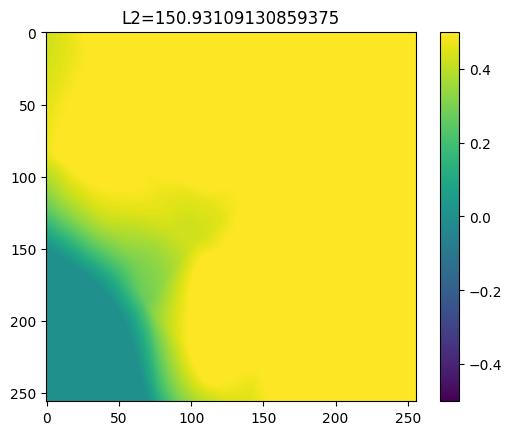

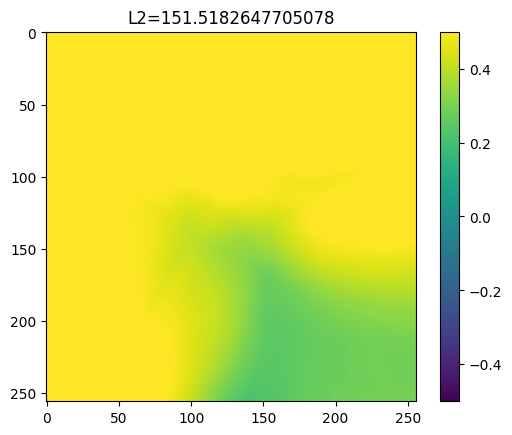

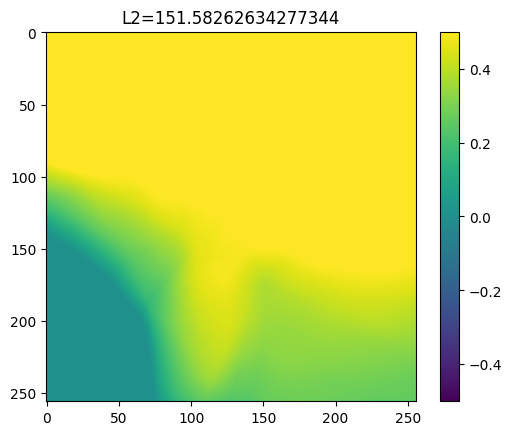

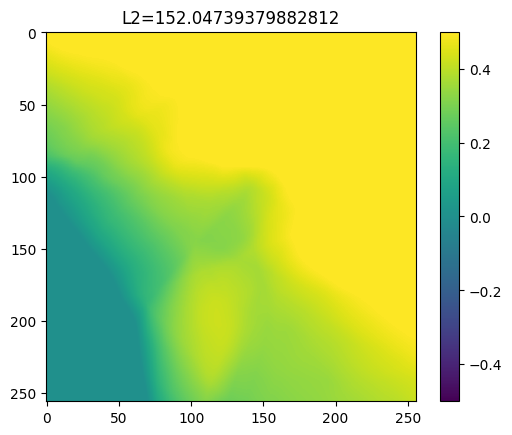

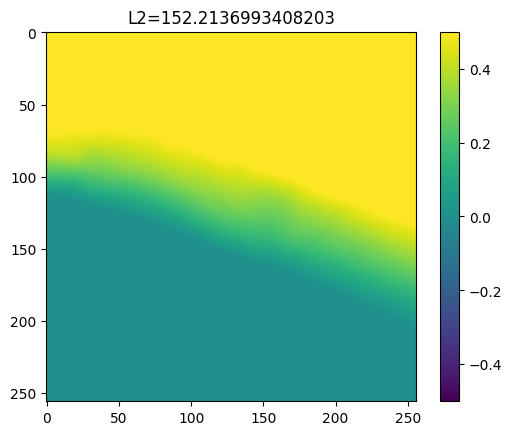

...

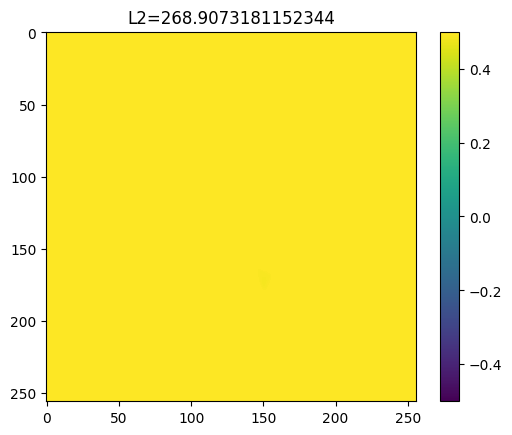

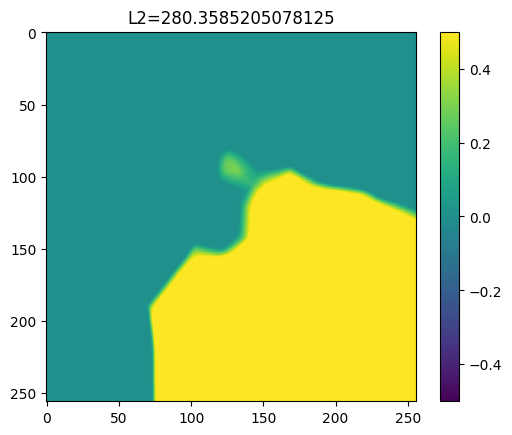

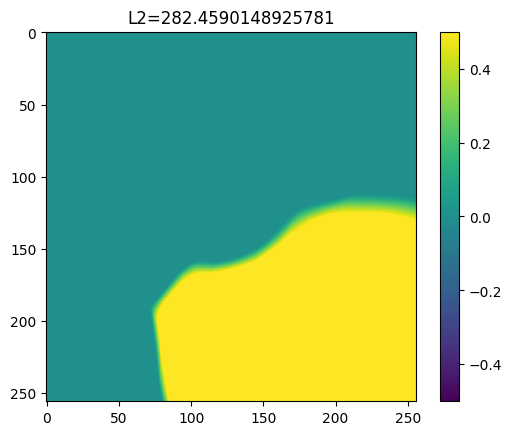

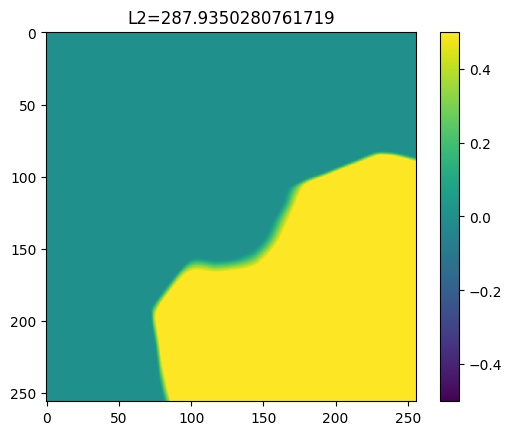

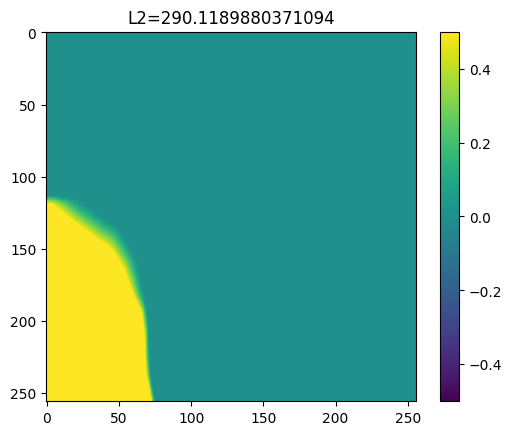

In [83]:
big_atoms_relu_3 = deep_neurons_relu_3[indx_relu_3[vals_relu_3.detach().cpu() > 150]]
big_vals_relu_3 = vals_relu_3[vals_relu_3.detach().cpu() > 150]

for atom, L2_val in zip(big_atoms_relu_3, big_vals_relu_3):
    plt.imshow(atom.detach().cpu().reshape((256,256)), vmin=-0.5, vmax=0.5)
    plt.colorbar()
    plt.title('L2={}'.format(torch.linalg.norm(L2_val)))
    plt.show()

## Hat Experiments

Step 0, Total loss 0.677271


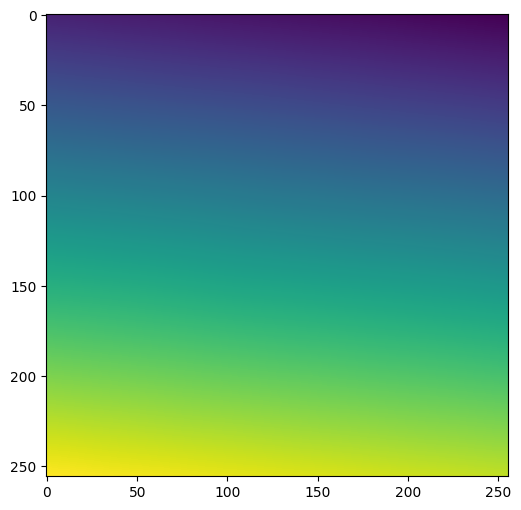

Step 10, Total loss 0.366328


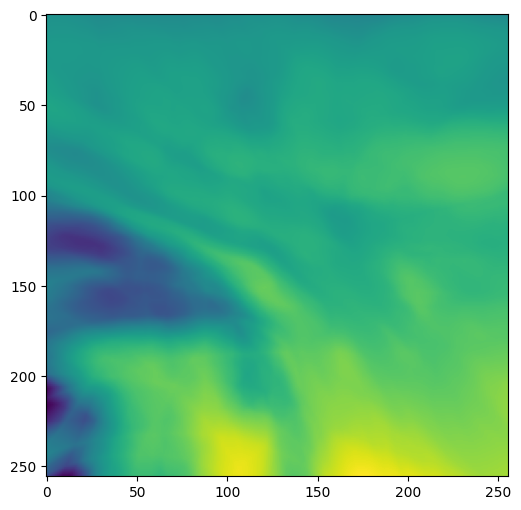

Step 20, Total loss 0.079980


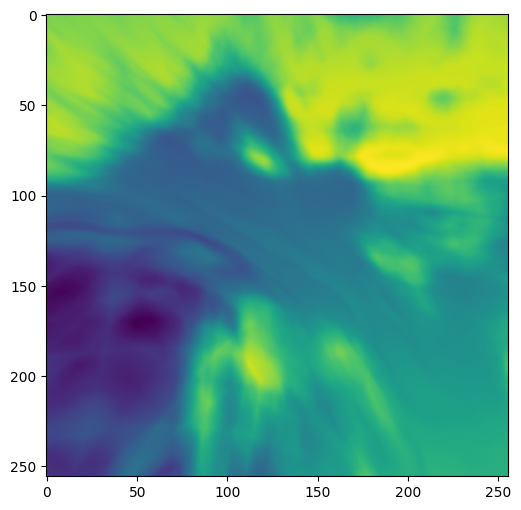

Step 30, Total loss 0.045371


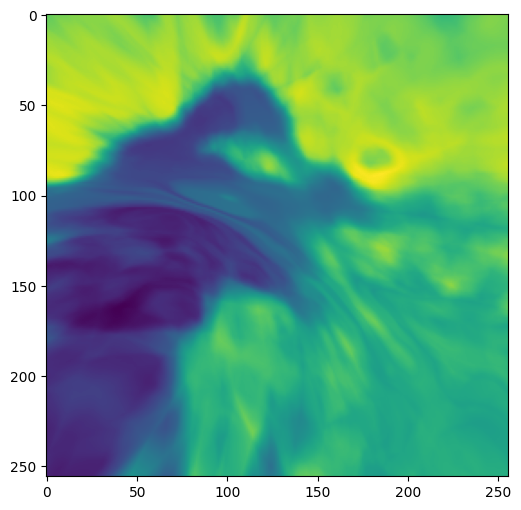

Step 40, Total loss 0.030337


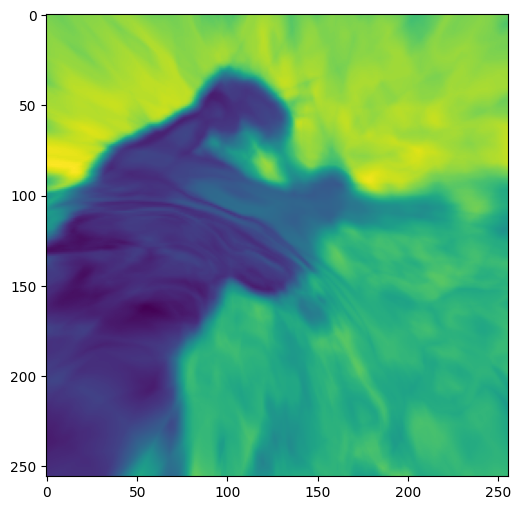

Step 50, Total loss 0.029533


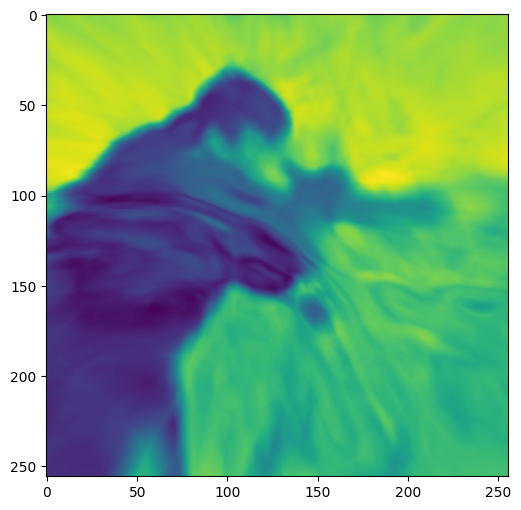

Step 60, Total loss 0.021837


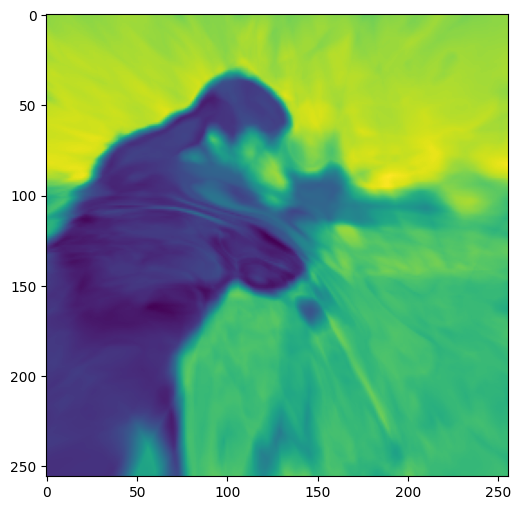

Step 70, Total loss 0.018465


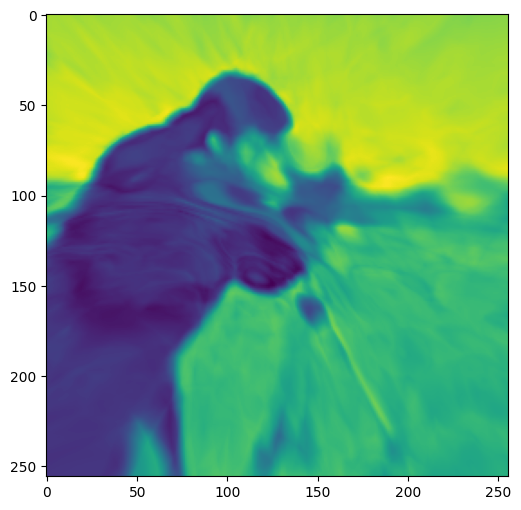

Step 80, Total loss 0.021086


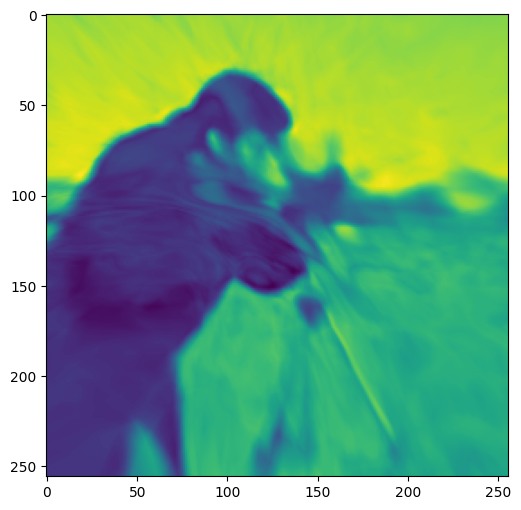

Step 90, Total loss 0.015755


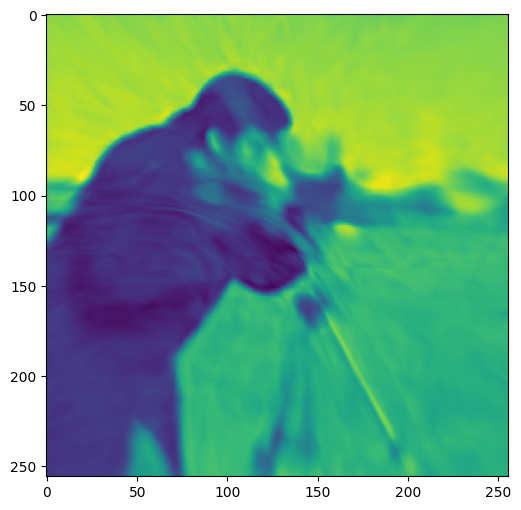

Step 100, Total loss 0.013977


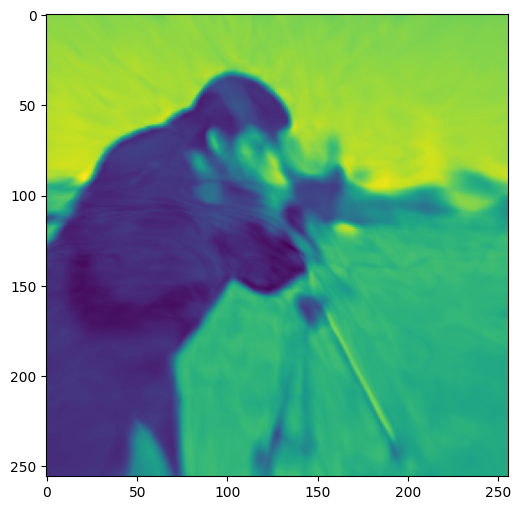

Step 110, Total loss 0.017341


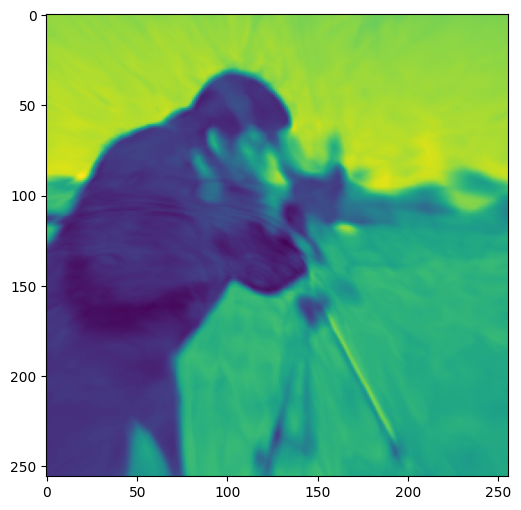

Step 120, Total loss 0.013784


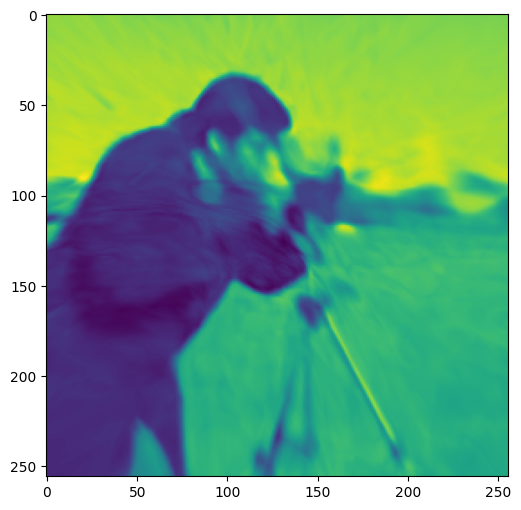

Step 130, Total loss 0.012152


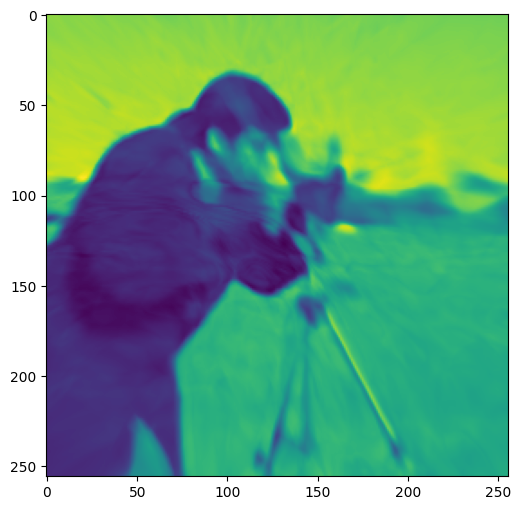

Step 140, Total loss 0.016394


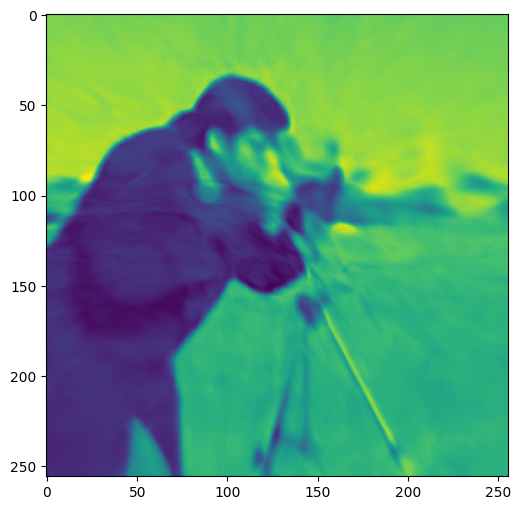

Step 150, Total loss 0.011348


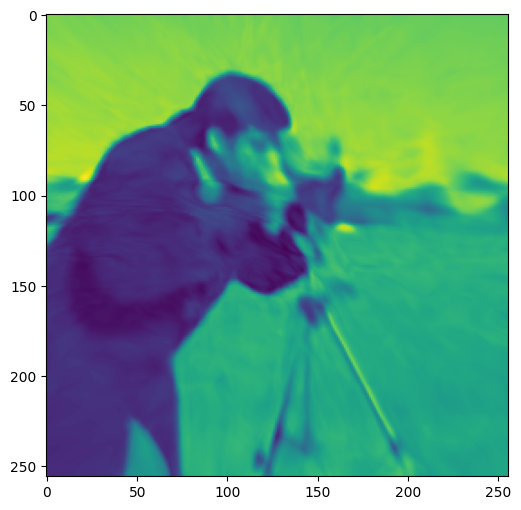

Step 160, Total loss 0.013323


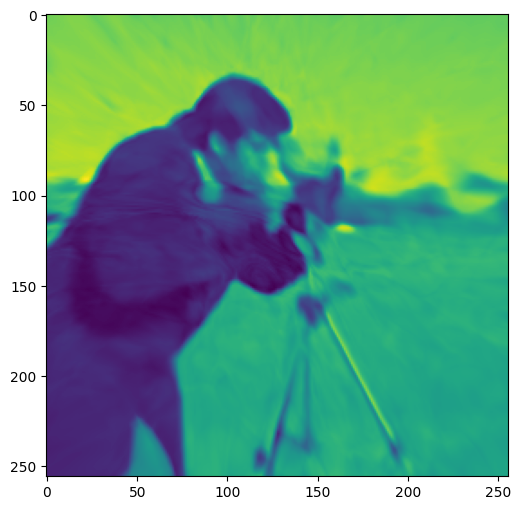

Step 170, Total loss 0.012452


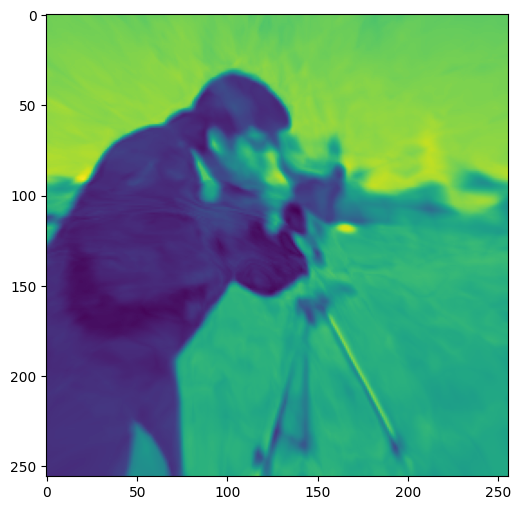

Step 180, Total loss 0.012342


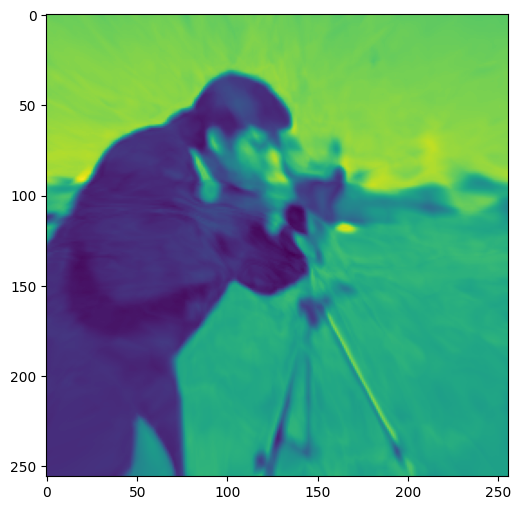

Step 190, Total loss 0.009746


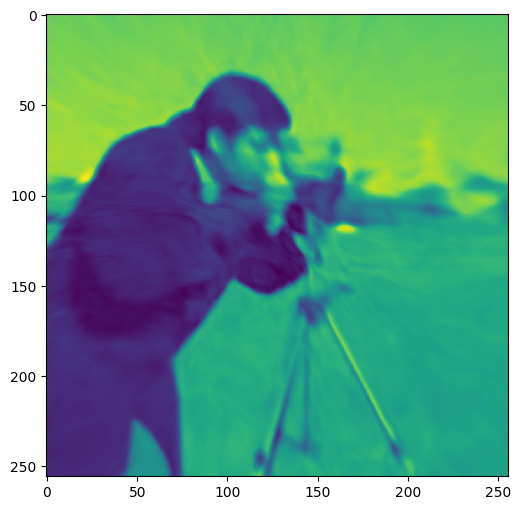

Step 200, Total loss 0.011044


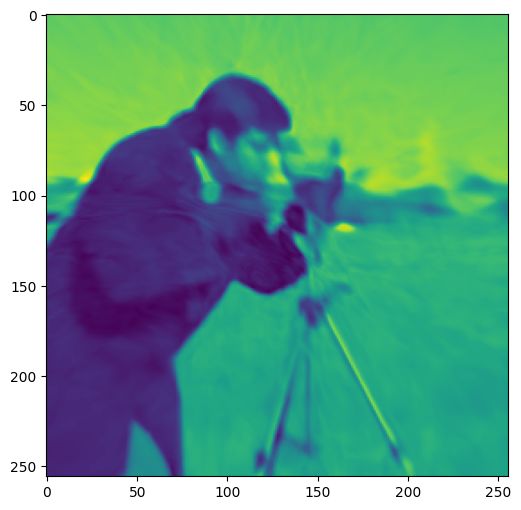

Step 210, Total loss 0.011200


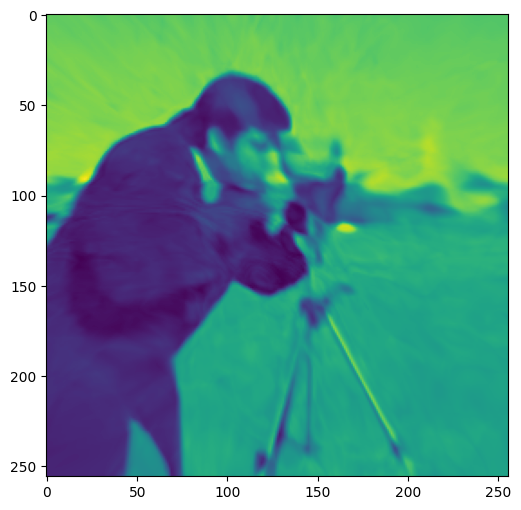

Step 220, Total loss 0.011337


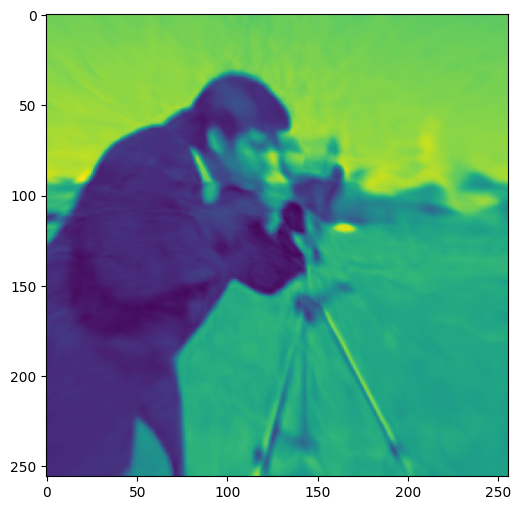

Step 230, Total loss 0.010239


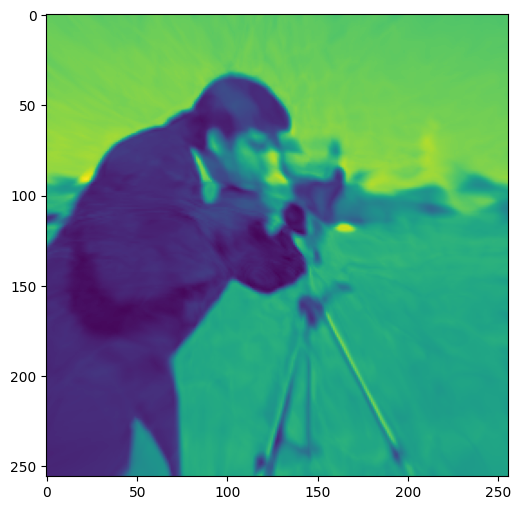

Step 240, Total loss 0.010843


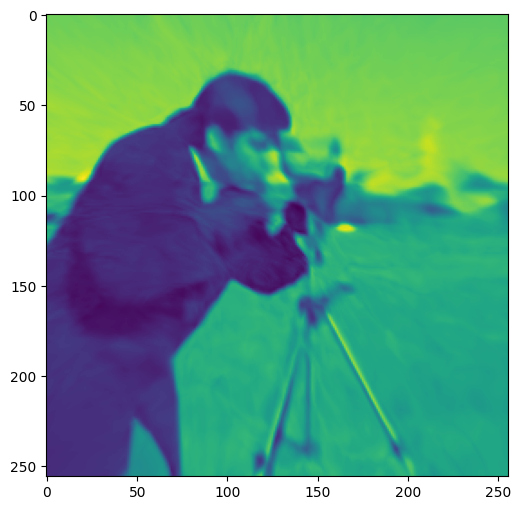

Step 250, Total loss 0.011805


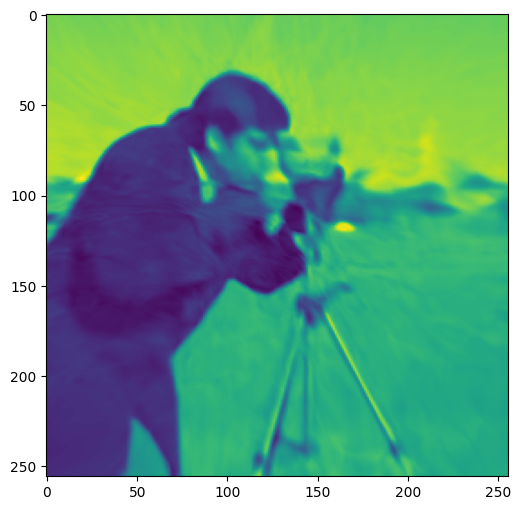

Step 260, Total loss 0.008791


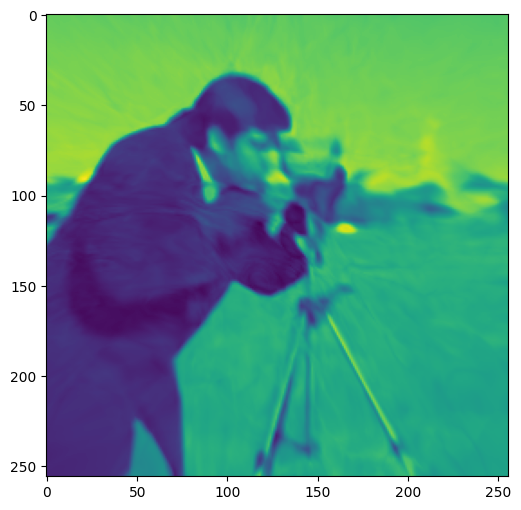

Step 270, Total loss 0.007888


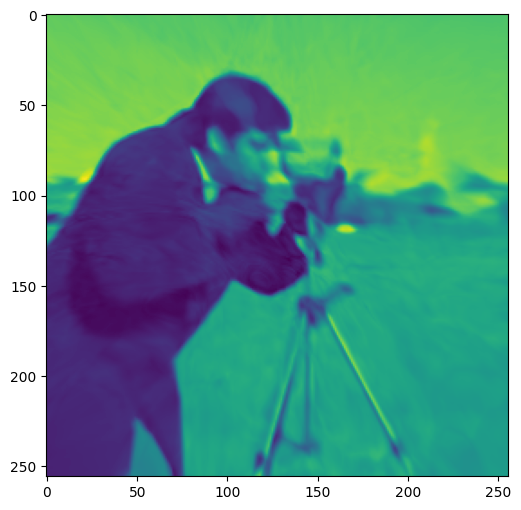

Step 280, Total loss 0.009123


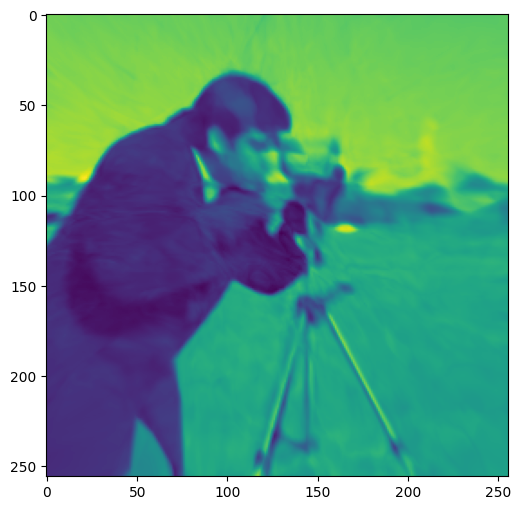

Step 290, Total loss 0.010515


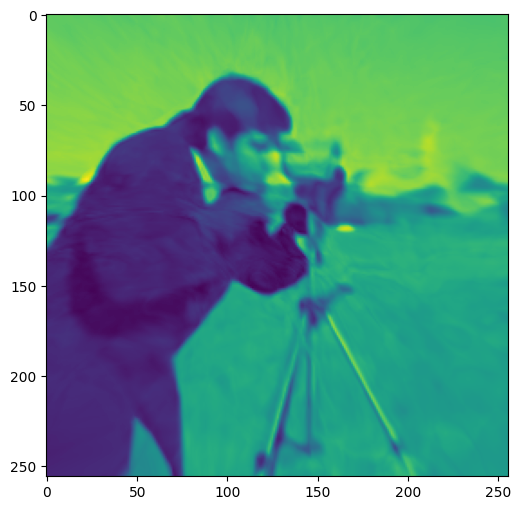

Step 300, Total loss 0.009014


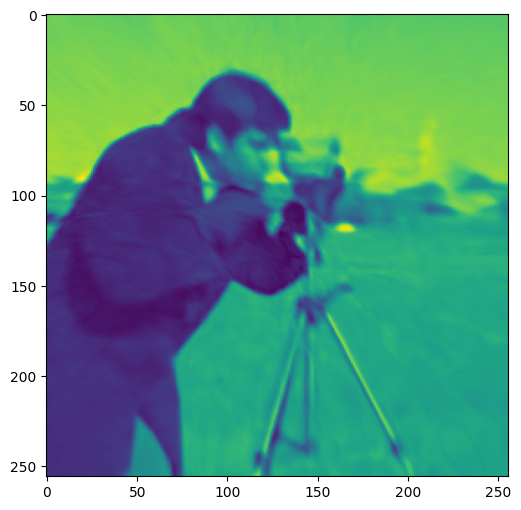

Step 310, Total loss 0.008395


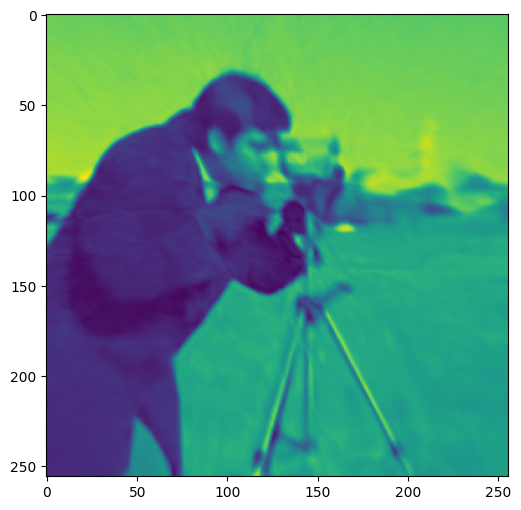

Step 320, Total loss 0.010976


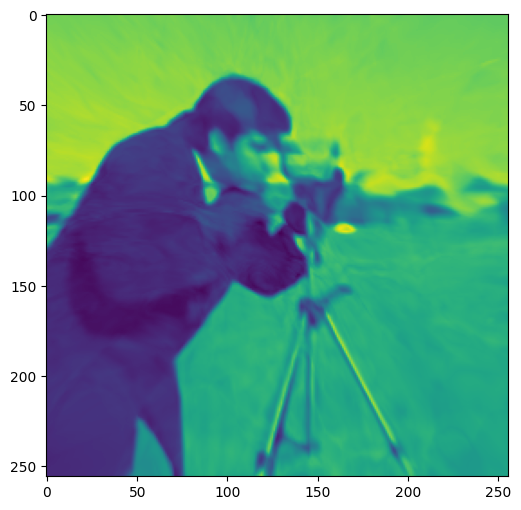

Step 330, Total loss 0.010355


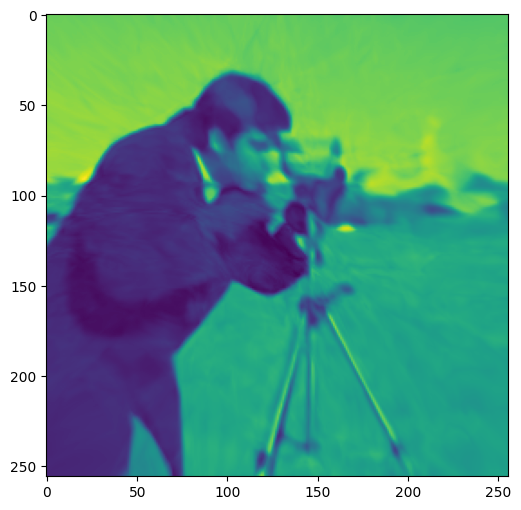

Step 340, Total loss 0.010707


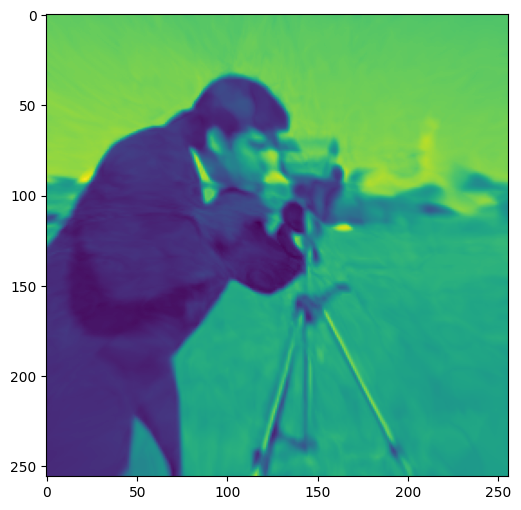

Step 350, Total loss 0.008881


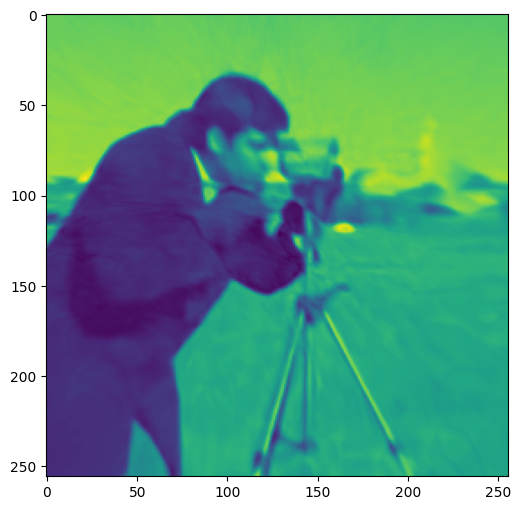

Step 360, Total loss 0.006446


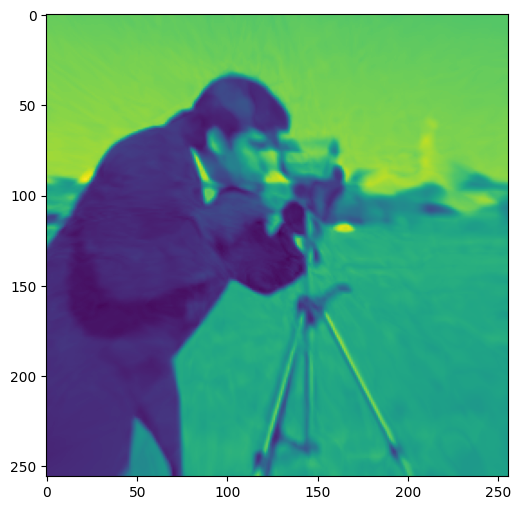

Step 370, Total loss 0.007031


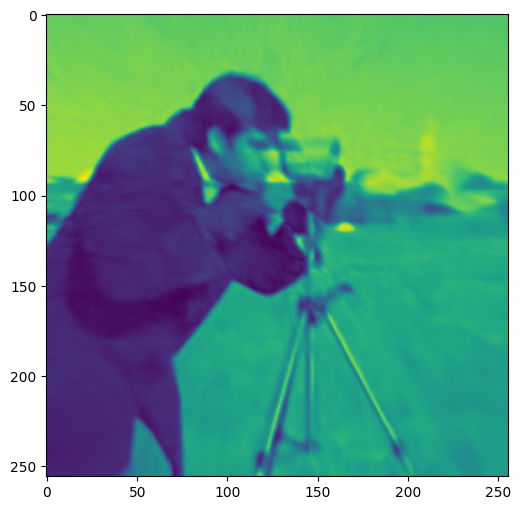

Step 380, Total loss 0.006954


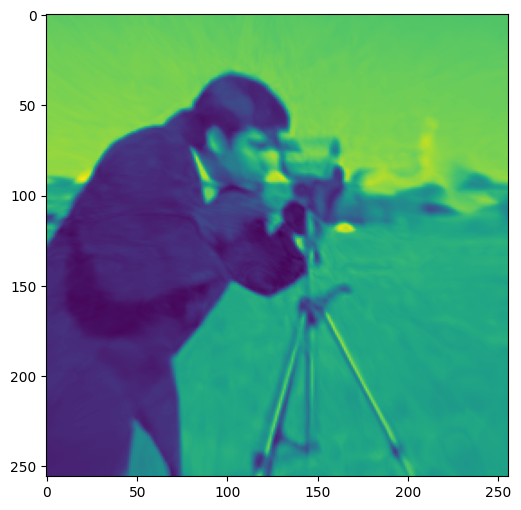

Step 390, Total loss 0.006445


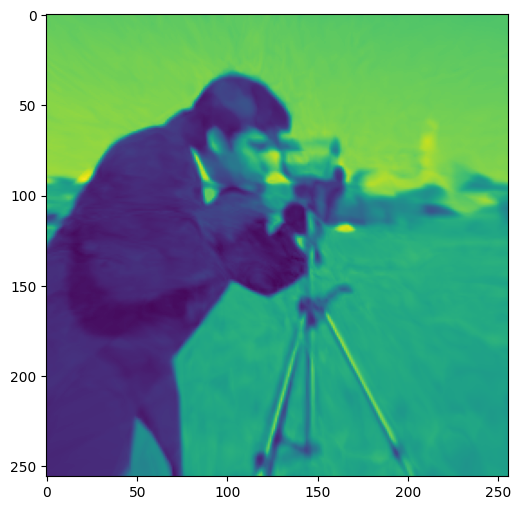

Step 400, Total loss 0.008515


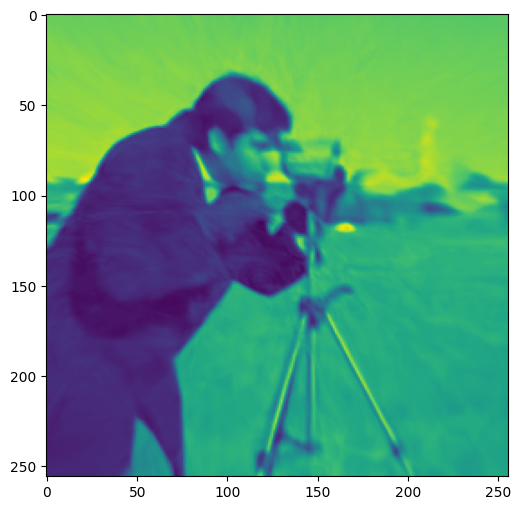

Step 410, Total loss 0.010911


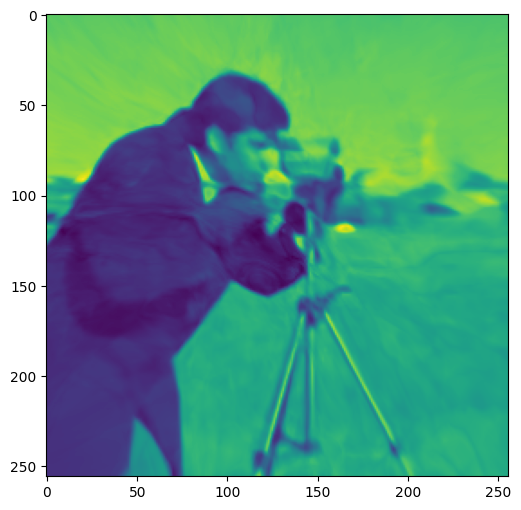

Step 420, Total loss 0.008981


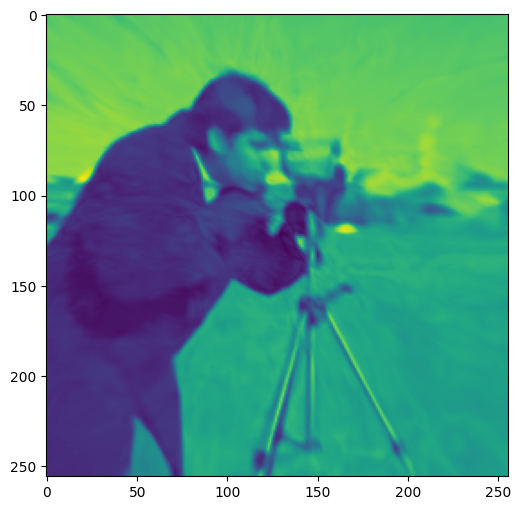

Step 430, Total loss 0.008316


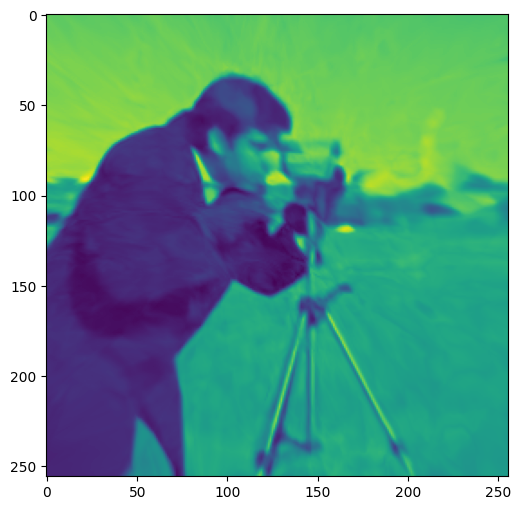

Step 440, Total loss 0.007383


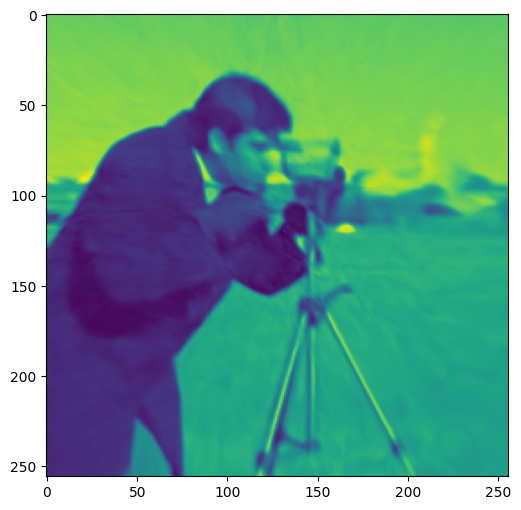

Step 450, Total loss 0.007116


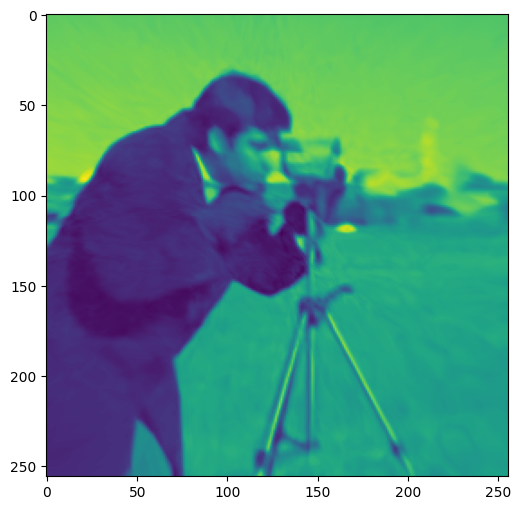

Step 460, Total loss 0.005773


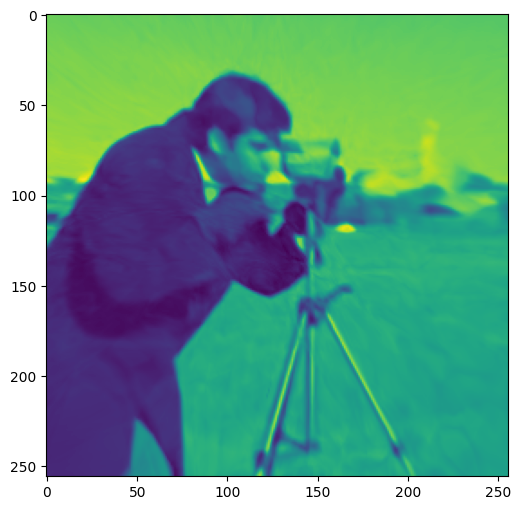

Step 470, Total loss 0.005855


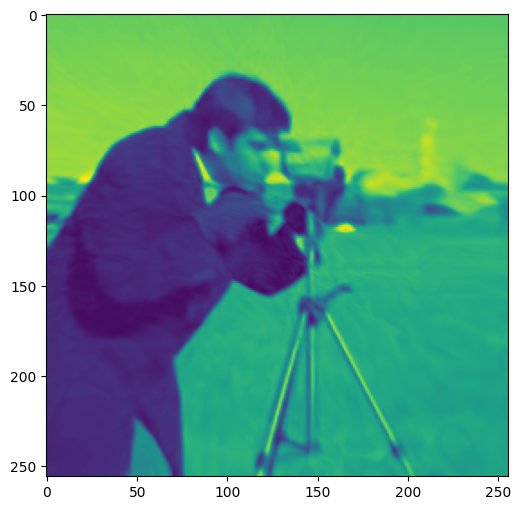

Step 480, Total loss 0.005835


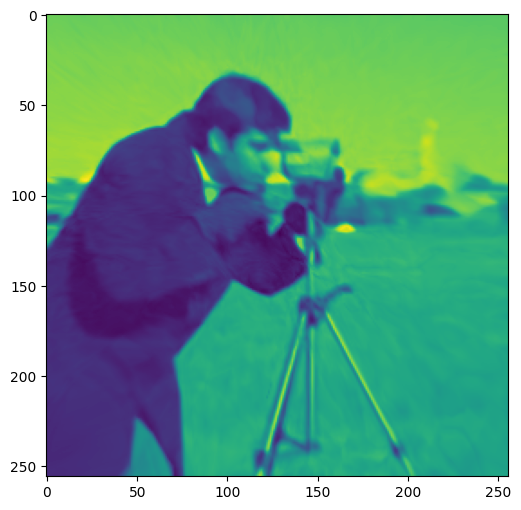

Step 490, Total loss 0.008193


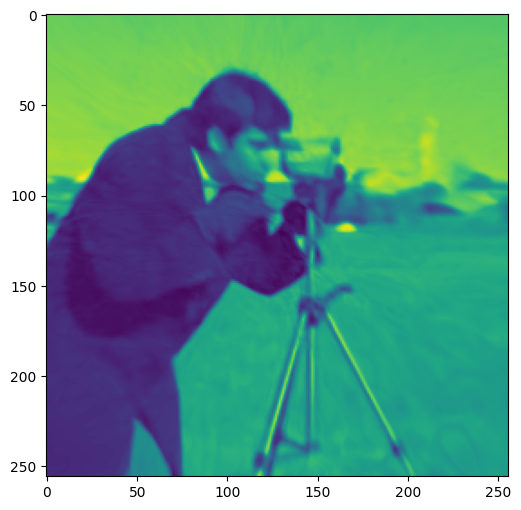

In [148]:
model = MLP_skip(2, 1000, 1, get_act_func('hat'), 3)
model.to('cuda:0')

total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=9e-3, params=model.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.to('cuda:0'), ground_truth.to('cuda:0')
model_input = model_input[0]

loss_hat = [] 

for step in range(total_steps):
    model_output, _ = model(model_input)    
    loss = ((model_output - ground_truth)**2).mean()
    loss_hat.append(loss.item())
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))

        fig = plt.figure(figsize=(6,6))
        plt.imshow(model_output.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

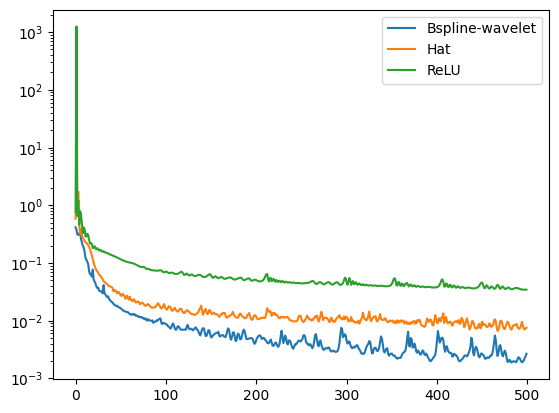

In [18]:
plt.semilogy(loss_bspline, label='Bspline-wavelet')
plt.semilogy(loss_hat, label='Hat')
plt.semilogy(loss_relu, label='ReLU')
plt.legend()
plt.show()